# House Price Prediction - Comprehensive Data Science Project
### —— Data Science Project for Exploratory Data Analysis (EDA), Statistical Inference, Feature Engineering, and Machine Learning.

#### Dataset downloaded from Kaggle
[<span style='color:#1f77b4'>**House Prices - Advanced Regression Techniques**</span>](https://www.kaggle.com/c/house-prices-advanced-regression-techniques/data)

### Life cycle of the Project:
- <span style='color:blue'>**Understand the Problem**</span>
- <span style='color:blue'>**Exploratory Data Analysis (Part 1)**</span>
  - <span style='color:blue'>whole picture of the data</span>
  - <span style='color:blue'>univariate analysis</span>

- Exploratory Data Analysis (Part 2)
  - Variable Correlation/Dependency Analysis
  - inferential statistics with hypothesis testing

- Feature Engineering
- Feature Importance Analysis
- Machine Learning Model Building, evaluation, and deployment

# Exploratory Data Analysis Phase_Part 1
#### explore and understand the data, provide as much information as possible to upcoming statistical inference and feature engineering.

<a name="0"></a>
# Content Outline
- [1. Understand the Problem](#1)
- [2. Whole Picture of Data](#2)
  - [2.0 Packages, Datasets, and Customized Functions Used in EDA Part 1](#2.0)
    - [Packages](#2.0.1)
    - [Version Information](#2.0.2)
    - [Datasets](#2.0.3)
    - [Customized Functions in EDA Part 1](#2.0.4)
  - [2.1 Quick Glance at The Data](#2.1)
  - [2.2 Preliminary Data Manipulation](#2.2)
    - [2.2.0 data type overview](#2.2.0)
    - [2.2.1 missing data](#2.2.1)
    - [2.2.2 drop features](#2.2.2)
    - [2.2.3 data type transformation](#2.2.3)
    - [2.2.4 cardinality comparison of categorical features](#2.2.4)
    - [2.2.5 outliers](#2.2.5) 
- [3. Univariate Analysis](#3)
  - [3.0 Updated Feature Type Segmentation](#3.0)
  - [3.1 Response / Target Variable](#3.1)
  - [3.2 Numerical Features](#3.2)
    - [3.2.1 year-related features](#3.2.1)   
    - [3.2.2 discrete numerical features](#3.2.2)
    - [3.2.3 continuous numerical features](#3.2.3)
  - [3.3 Categorical Features](#3.3)
    - [3.3.1 ordinal categorical features](#3.3.1)  
    - [3.3.2 nominal categorical features](#3.3.2)  
- [EDA Part 1 summary](#4)


<a name="1"></a>
# 1. Understand the Problem
This project will be utilizing Dataset [<span style='color:blue'>**House Price - Advanced Regression Techniques**</span>](https://www.kaggle.com/c/house-prices-advanced-regression-techniques/data) to explore several important data science topics. 
### Problems
Followings are the main problems involved in this project:
- comprehensive Exploratory Data Analysis (EDA)
- Statistical Inference with Hypothesis Testing
- Feature Engineering pipeline
- Feature Importance Analysis with regularized Linear Regression models
- Machine Learning model building (XGBoost, Neural Network with Tensorflow)

### Goals
Followings are the main goals to achieve in this project:
- extract information from the dataset to figure out relationship between features and house sale price
- reveal insight intuitively from EDA with data visualization and inferencial statistics
- construct Feature Engineering pipeline for Machine Learning model building
- analyze the most important factors in house sale price prediction through feature importance analysis
- build Machine Learning models to reasonably predict better house sale price 


<a name="2"></a>
# 2. Whole Picture of Data

- [2.0 Packages, Datasets, and Customized Functions Used in EDA](#2.0)
  - import python modules
  - import datasets
  - define functions used in EDA
- [2.1 Quick Glance at The Data](#2.1) 
  basic information, summary statistics, missing data
- [2.2 Preliminary Data Manipulation](#2.2)
  - data type overview, fill and imputate missing data, drop features, data type transformation, cardinality analysis, outliers


<a name="2.0"></a>
## 2.0 Packages, Datasets, and Customized Functions Used in EDA
- [Packages](#2.0.1)
- [Version Information](#2.0.2)
- [Datasets](#2.0.3)
- [Customized Functions in EDA Part 1](#2.0.4)

<a name="2.0.1"></a>
### Packages

In [1]:
### install some packages as needed
# !pip install missingno

In [2]:
###### import modules ####################################
%matplotlib inline

import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.offsetbox import AnchoredText # for text annotation in plt plots
import seaborn as sns
import missingno as msno
import re
import scipy.stats as stats # for QQ plot

import session_info
import warnings
import inspect
import json

# warnings.filterwarnings('ignore') ## ignore warnings
pd.pandas.set_option('display.max_columns',None) # Display all the columns of the dataframe

<a name="2.0.2"></a>
### version information for all imported modules
- use `session_info` to output version information for modules loaded in the current session, Python, the OS, and the CPU.
- version information is provided to increase reproducibility

In [8]:
session_info.show(std_lib=True, html=False)

-----
inspect             NA
io                  NA
json                2.0.9
matplotlib          3.6.2
missingno           0.5.1
numpy               1.23.4
pandas              1.5.1
re                  2.2.1
scipy               1.9.3
seaborn             0.12.1
session_info        1.0.0
warnings            NA
-----
IPython             8.6.0
jupyter_client      7.4.5
jupyter_core        5.0.0
jupyterlab          3.5.0
notebook            6.5.2
-----
Python 3.10.2 (tags/v3.10.2:a58ebcc, Jan 17 2022, 14:12:15) [MSC v.1929 64 bit (AMD64)]
Windows-10-10.0.22000-SP0
-----
Session information updated at 2022-11-14 06:02


<a name="2.0.3"></a>
### Datasets

In [9]:
###### import dataset: train.csv, test.csv #######################
main_df = pd.read_csv('datasets/train.csv')
main_df.name = 'main_df'
test_df = pd.read_csv('datasets/test.csv')
test_df.name = 'test_df'

<a name="2.0.4"></a>
### Customized Functions in EDA Part 1

In [10]:
### function that returns overall summary of data frame
def dataset_summarize(df, include_cat = False):
    """
    Return data frame summary.
    
    Params:
    --------
    df (pd.DataFrame): data frame
    include_cat (bool): if True, count variables with dtype 'category'
    
    Returns:
    --------
    overall summary of data frames
    
    """
    
    num_cat_features = df.select_dtypes('object').shape[1]
    num_numerical_features = df.select_dtypes(['int', 'float']).shape[1]
    percent_missing_values = df.isnull().sum().sum()/(df.shape[0] * df.shape[1]) * 100
    
    if include_cat == True:
        num_ordcat_features = df.select_dtypes('category').shape[1]
        print("number of variables in dtype 'category': {} \n".format(num_ordcat_features))
    
    print("number of variables in dtype 'object': {} \n".format(num_cat_features))
    print("number of variables in dtype 'int' or 'float': {} \n".format(num_numerical_features))
    print('data frame shape: {} \n'.format(df.shape))
    print('missing value percentage: {0: .2f} %'.format(percent_missing_values))
    
    return
    

In [11]:
### function that returns missing data summary of a data frame
def missing_data_summarize(df):
    """
    Get missing data summary.
    
    Params:
    --------
    df (pd.DataFrame): data frame
    
    Returns:
    --------
    pd.DataFrame: summary data frame
        index  : column names of df
        columns: 'missing_data_percentage', 
                 'missing_entry': number of missing entries,
                 'dtype': data type of the corresponding column of df
    
    """ 
    if df.isnull().sum().sum() == 0:
        print('No missing data in the data frame.')
        
        return
    
    missing_data_sorted = df.loc[:, df.isnull().any()].isnull().mean().sort_values(ascending = False) * 100
    feature_dtype = df[missing_data_sorted.index].dtypes
    missing_entry = df[missing_data_sorted.index].isnull().sum()
    
    return pd.DataFrame({'missing_data_percentage': missing_data_sorted, 
                         'missing_entry': missing_entry, 
                         'dtype': feature_dtype})


In [12]:
### function that returns matched/ummatched features with missing data
def missing_data_compare(df1, df2):
    """
    Extract and compare features with missing data in two data frams.
    
    Params:
    --------
    df1, df2 (pd.DataFrame): data frame
    
    Returns:
    --------
    information of shared and unique features with missing
    data in df1 and df2
    
    """ 
    if (df1.isnull().sum().sum() == 0) and (df2.isnull().sum().sum() == 0):
        print('No missing data in df1 or df2.')
    elif (df1.isnull().sum().sum() == 0) and (df2.isnull().sum().sum() != 0):
        print('No missing data in df1.\n\n')
        df2_features = missing_data_summarize(df2).index
        print('{} features with missing data in df2:\n\n {}\n\n'.format(len(df2_features), df2_features))
    elif (df1.isnull().sum().sum() != 0) and (df2.isnull().sum().sum() == 0):
        print('No missing data in df2.\n\n')
        df1_features = missing_data_summarize(df1).index
        print('{} features with missing data in df1:\n\n {}\n\n'.format(len(df1_features), df1_features))
    else:
        missing_df1, missing_df2 = missing_data_summarize(df1), missing_data_summarize(df2)
        feature_set1, feature_set2 = missing_df1.index, missing_df2.index
        shared_features = [i for i in feature_set1 if i in feature_set2]
        df1_features = [i for i in feature_set1 if i not in feature_set2]
        df2_features = [i for i in feature_set2 if i not in feature_set1]

        print('\n{} features with missing data in both df1 and df2:\n\n {}\n\n'.format(len(shared_features), shared_features))
        print('{} features with missing data in only df1:\n\n {}\n\n'.format(len(df1_features), df1_features))
        print('{} features with missing data in only df2:\n\n {}\n\n'.format(len(df2_features), df2_features))
    
    return
   

In [13]:
### function that returns single feature text description and basic summary
def single_feature_describe(feature_name, df=main_df, text_description=True):
    """
    Get single feature description and basic information in a data frame.
    
    Params:
    --------
    df (pd.DataFrame): data frame
    
    feature_name (str): feature/column name
    
    Returns:
    --------
    feature description and basic information
    
    Notes:
    --------
    Text description comes from data_description.txt
    
    """
    if (feature_name not in set(df.columns)) or (type(feature_name) != str):
        print('Invalid feature name.')
        
        return
    
    feat_names = main_df.iloc[:, 1:-1].columns.tolist()
    
    if (feature_name in feat_names) and (text_description == True):
        with open('datasets/data_description.txt', 'r') as file:
            feature_description = file.read()
        
        if feature_name != 'SaleCondition':
            next_feat = feat_names[feat_names.index(feature_name) + 1]
            pattern = '({}:[\w\t\n-/\.<:]+){}:'.format(feature_name.removesuffix('AbvGr'), 
                                                       next_feat.removesuffix('AbvGr'))
            # use .removesuffix('AbvGr') since in data_descreption.txt, feature 'BedroomAbvGr' is 'Bedroom',
            # feature 'KitchenAbvGr' is 'Kitchen'
        else: ## feature_name == 'SaleCondition'
            pattern = '{}[\w\t\n-/\.<:]+'.format(feature_name)

        print('feature description from data_description.txt:\n')
        print(re.findall(pattern, feature_description)[0])
        print('=' * 50 + '\n')
    
    if (feature_name not in set(main_df.columns)) and (text_description == True):
        print('Feature {} does not exist in the original dataset.'.format(feature_name))
        print('=' * 50 + '\n')
    
    if df[feature_name].dtype == 'O':
        print('unique value counts in the data frame: \n')
        print(df[feature_name].value_counts())
    
    if (df[feature_name].dtype in ['int64', 'float64']) and (len(df[feature_name].unique()) <= 30):
        print('unique value counts in the data frame: \n')
        print(df[feature_name].value_counts())
    
    if (df[feature_name].dtype in ['int64', 'float64']) and (len(df[feature_name].unique()) > 30):
        print('feature summary statistic: \n')
        print(df[feature_name].describe())
        print('=' * 50 + '\nskewness: {0: .3f}'.format(df[feature_name].skew()))
    
    print('=' * 50 + '\n\nmissing data percentage: {0: .2f} %'.format(df[feature_name].isnull().mean() * 100))
    print('\nnumber of missing entires: {}'.format(df[feature_name].isnull().sum()))
    
    return


In [14]:
### function that fills missing data with specific meaning
def missing_relpace(df, feas_na_replace, feas_na_replace_only_test):
    """
    Fill data frame's missing values with specific meanings.
    
    Params:
    --------
    df (pd.DataFrame): data frame
    
    feas_na_replace (list): categorical(nominal and ordinal) feature list
    
    feas_na_replace_only_test (list): numerical(discrete and continuous) feature list 
    
    Returns:
    --------
    pd.DataFrame with corresponding missing values filled
    
    Notes:
    --------
    Features in feas_na_replace_only_test only have features with 
    missing values in dat_test
    
    """
    if not set(feas_na_replace).issubset(set(df.columns)):
        print('One or more features in feas_na_replace are not in df')
        
        return
    
    if not set(feas_na_replace_only_test).issubset(set(df.columns)):
        print('One or more features in feas_na_replace_only_test are not in df')
        
        return
    
    data = df.copy()
    for feature in feas_na_replace:
        if 'Bsmt' in feature:   ## features with 'Bsmt' in name
            data[feature] = data[feature].fillna('No Basement')
        elif 'Garage' in feature:   ## ## features with 'Garage' in name
            data[feature] = data[feature].fillna('No Garage')
        elif feature == 'Alley':
            data[feature] = data[feature].fillna('No alley access')
        elif feature == 'FireplaceQu':
            data[feature] = data[feature].fillna('No Fireplace')
        elif feature == 'PoolQC':
            data[feature] = data[feature].fillna('No Pool')
        elif feature == 'Fence':
            data[feature] = data[feature].fillna('No Fence')
        else:  ## feature == 'MiscFeature'
            data[feature] = data[feature].fillna('None')
    
    data[feas_na_replace_only_test] = data[feas_na_replace_only_test].fillna(0) ## only works for dat_test
        
    return data


In [15]:
### function that fills missing data via imputation
def missing_imputate(df, feas_na_imputate):
    """
    Fill data frame's missing values by imputation.
    
    Params:
    --------
    df (pd.DataFrame): data frame
    
    feas_na_imputate (list): list of features for imputation 
    
    Returns:
    --------
    pd.DataFrame with corresponding missing values filled
    
    Notes:
    --------
    Imputation only uses information (mode / median) from main_df (training data) 
    to prevent data leakage.
    
    Information of main_df is used to impute missing data in 
    both dat_main and dat_test.
    
    """
    if not set(feas_na_imputate).issubset(set(df.columns)):
        print('One or more features in feas_na_imputate are not in df')
        
        return
    
    data = df.copy()
    for feature in feas_na_imputate:
        if feature == 'MasVnrArea':
            data[feature] = data[feature].fillna(0)
        elif feature == 'LotFrontage':
            neighbor_median_dict = main_df.groupby('Neighborhood')['LotFrontage'].median().to_dict()
            data[feature] = data.apply(lambda row: neighbor_median_dict[row['Neighborhood']] if np.isnan(row[feature]) else row[feature], axis = 1)
        else: ## all other categorical features in the list
            fill_value = main_df[feature].mode()[0]
            data[feature] = data[feature].fillna(fill_value)
            
    return data


In [16]:
### function that checks if a categorical feature from df1 matches or includes all categories of the same feature from df2
def cat_feat_check(df1, df2, cat_feat_lst):
    """
    Check if a categorical feature from df1 matches or includes all 
    categories of the same feature from df2.
    
    Params:
    --------
    df1, df2 (pd.DataFrame): data frame
    cat_feat_lst (list): list of features for checking 
    
    Returns:
    --------
    feat_match_lst (list): list of features that meet the condition: 
                           included if a feature from df1 matches or includes all categories 
                           of this feature from df2
    feat_no_match_lst (list): list of features that DO NOT meet the condition:
                              included if a feature from df1 has less or does not match all categories 
                              of this feature from df2
    
    Notes:
    --------
    Pay attention to the order of df1 and df2.
    
    """
    if not set(cat_feat_lst).issubset(set(df1.columns)):
        print('One or more features are not in df1.')
        return
    
    if not set(cat_feat_lst).issubset(set(df2.columns)):
        print('One or more features are not in df2.')
        return
    
    feat_match_lst = []
    feat_no_match_lst = []
    for feature in cat_feat_lst:
        cat_set_df1 = set(df1[feature].unique())
        cat_set_df2 = set(df2[feature].unique())
        
        if cat_set_df2.issubset(cat_set_df1): # True if two sets equal or cat_set_df1 includes cat_set_df2
            feat_match_lst.append(feature)
        else:
            feat_no_match_lst.append(feature)
    
    return feat_match_lst, feat_no_match_lst
        

In [17]:
### function that plots continuous numerical variable in different plot types
def plot_numerical_var(df, feature):
    """
    create histogram, probability plot (QQ-plot), and boxplot in a 
    single figure for a (continuous) numerical variable in a data frame
    
    Params:
    --------
    df (pd.DataFrame): data frame
    feature (str): feature name 
    
    Returns:
    --------
    plt figure which combines 3 subplots
    
    """ 
    if (feature not in df.columns) or (df[feature].dtype not in ['int64', 'float64']) or (type(feature) != str):
        print('Invalid feature name.')
        
        return
    
    plt.figure(figsize=(8,6))
    ax1 = plt.subplot2grid((7, 7), (0, 0), colspan=5, rowspan=3) # for histogram
    ax2 = plt.subplot2grid((7, 7), (3, 0), colspan=5, rowspan=4) # for qq plot
    ax3 = plt.subplot2grid((7, 7), (0, 5), colspan=2, rowspan=7) # for boxplot
    
    sns.histplot(x = feature, data = df, kde = True, ax = ax1);
    stats.probplot(df[feature], plot = ax2)
    sns.boxplot(y = feature, data = df, ax = ax3)
    plt.tight_layout()
    sns.despine()
    
    return plt.show()


In [18]:
### function that creates plot matrix to show feature vs target variable relationship
def plot_feat_target(df, feat_lst, target_var, kind, show_corr = False, draw_line = True, x_rotate_feat = None):
    """
    create plot matrix to show multiple feature vs. target 
    relationship and correlation coefficients in a data frame
    
    Params:
    --------
    df (pd.DataFrame)     : data frame
    feat_lst (list of str): feature names
    target_var (str)      : target variable name
    
    kind (str): plot type: {'regplot', 'violin', 'point_scatter', 'point_strip', 'kde'}, 
                'regplot'      : sns.regplot(), for continuous numerical features
                'violin'       : sns.violinplot(), for discrete numerical/categorical features
                'box_strip'    : sns.boxplot(), for discrete numerical/categorical feature
                'point_scatter': plt pointplot + scatterplot, for discrete numerical features
                'point_strip'  : sns.pointplot() + sns.stripplot(), for categorical features
                'kde'          : sns.kdeplot(), for categorical features
                
    show_corr (bool): show Pearson and/or Spearman correlation coefficients in plots,
                 only apply to 'regplot'/'point_scatter' plot type
                 
    draw_line (bool): if True, lines will be drawn between point estimates in sns.pointplot()
                 only apply to 'point_strip' plot type
    
    x_rotate_feat (list): a list of features for x label 90-degree rotation in plot,
                 apply to 'violin' / 'box_strip' / 'point_strip' plot type
    
    Returns:
    --------
    plt figure of plot matrix
    
    """
    if kind not in ['regplot', 'violin', 'box_strip', 'point_scatter', 'point_strip', 'kde']:
        print('Invalid plot type.')
        return
    
    if not set(feat_lst).issubset(set(df.columns)):
        print('One or more features are not in the data frame.')
        return
    
    if target_var not in df.columns:
        print('Target variable is not in the data frame.') 
        return
    
    if len(feat_lst) == 1:
        fig, axs = plt.subplots(1, 1, figsize = (6, 4))
        axs = [axs]  
    else: # more than 1 feature in the list
        fig_row_num = np.ceil(len(feat_lst)/2).astype(int)
        fig_width = 12
        fig_height = fig_row_num * 4
        fig, axs = plt.subplots(fig_row_num, 2, figsize = (fig_width, fig_height))
        axs = axs.flatten()
    
    if kind == 'regplot':
        for i, feature in enumerate(feat_lst):
            sns.regplot(x = feature, y = target_var, data = df, ci = None, ax = axs[i],
                        scatter_kws = {'alpha': 0.8, 'edgecolor': 'white'},
                        line_kws = {'color': '#ff7f0e', 'linewidth': 2})
            
            if show_corr:
                pearson_corr = df[feature].corr(df[target_var], method = 'pearson') # default method
                spearman_corr = df[feature].corr(df[target_var], method = 'spearman')
                text = '$\\rho$ = {:.2f}\nr = {:.2f}'.format(pearson_corr, spearman_corr)
                anchored_text = AnchoredText(text, loc = 'lower right', prop=dict(size=15), frameon=False)
                axs[i].add_artist(anchored_text)
    
    if kind == 'violin':
        for i, feature in enumerate(feat_lst):
            sns.violinplot(x = feature, y = target_var, data = df, ax = axs[i], bw=.5, palette='pastel')
            if x_rotate_feat is not None:
                degree = 90 if (feature in x_rotate_feat) else 0
                axs[i].tick_params(axis='x', rotation = degree)
    
    if kind == 'box_strip':
        for i, feature in enumerate(feat_lst):
            sns.boxplot(x = feature, y = target_var, data = df, ax = axs[i], palette='pastel')
            sns.stripplot(x = feature, y = target_var, hue = feature, data = df, alpha = 0.5, 
                          edgecolor = 'w', linewidth=0.3, legend = False, ax = axs[i])
            if x_rotate_feat is not None:
                degree = 90 if (feature in x_rotate_feat) else 0
                axs[i].tick_params(axis='x', rotation = degree)
       
    if kind == 'point_scatter':
        for i, feature in enumerate(feat_lst):
            mean_points = df.groupby(feature)[target_var].mean()
            plt.sca(axs[i])
            plt.scatter(x = feature, y = target_var, alpha = 0.3, data = df, edgecolor = 'white')
            if df[feature].dtype in ['int64', 'float64']:
                plt.xticks(np.arange(df[feature].min(), df[feature].max() + 1, 1))
            plt.plot(mean_points, marker = 'o', color = '#ff7f0e', markersize = 8)
            plt.xlabel(feature)
            plt.ylabel(target_var)
            
            if show_corr:
                spearman_corr = df[feature].corr(df[target_var], method = 'spearman')
                text = 'r = {:.2f}'.format(spearman_corr)
                anchored_text = AnchoredText(text, loc = 'upper center', prop=dict(size=15), frameon=False)
                axs[i].add_artist(anchored_text)
                
    if kind == 'point_strip':
        for i, feature in enumerate(feat_lst):
            sns.stripplot(x = feature, y = target_var, hue = feature, data = df, alpha = 0.9, edgecolor='white', 
                          linewidth=0.6, jitter = 0.3, palette = 'pastel', legend = False, ax = axs[i], zorder=1) # 
            sns.pointplot(x = feature, y = target_var, data = df, color = '#ff7f0e', 
                          ax = axs[i], join = draw_line)
            if x_rotate_feat is not None:
                degree = 90 if (feature in x_rotate_feat) else 0
                axs[i].tick_params(axis='x', rotation = degree)
    
    if kind == 'kde':
        for i, feature in enumerate(feat_lst):
            if len(df[feature].unique()) > 15: # if too many categories
                sns.kdeplot(x = target_var, hue = feature, data = df, ax = axs[i], legend = False)
                text = '{}:\n\n    {} categories'.format(feature, len(df[feature].unique()))
                anchored_text = AnchoredText(text, loc = 'upper right', prop=dict(size=11), frameon=True)
                anchored_text.patch.set_linewidth(0.5)
                anchored_text.patch.set_edgecolor('gray')
                axs[i].add_artist(anchored_text)
            else:
                sns.kdeplot(x = target_var, hue = feature, data = df, ax = axs[i])
            if len(df[feature].unique()) == 2:
                counts = df[feature].value_counts()
                cat = df[feature].value_counts().index.tolist()
                text=('{}:\n    count = {}\n    $\\mu$ = {:.2f}\n    $\\sigma$ = {:.2f}\n\n' \
                      '{}:\n    count = {}\n    $\\mu$ = {:.2f}\n    $\\sigma$ = {:.2f}'
                      .format(cat[0], counts[cat[0]],
                              df[df[feature] == cat[0]][target_var].mean(), 
                              df[df[feature] == cat[0]][target_var].std(),
                              cat[1], counts[cat[1]],
                              df[df[feature] == cat[1]][target_var].mean(), 
                              df[df[feature] == cat[1]][target_var].std()))
            
                anchored_text = AnchoredText(text, loc = 'upper left', prop=dict(size=13), frameon=False)
                axs[i].add_artist(anchored_text)
    
    plt.tight_layout()
    
    return plt.show()


In [19]:
### function that creates histogram matrix and skewness information for a list of continuous numerical features
def plot_hist_matrix(df, feat_lst, non_zero = False):
    """
    create histogram matrix multiple continuous numerical features in a data frame;
    provide skewness and zero proportion information
    
    Params:
    --------
    df (pd.DataFrame): data frame
    feat_lst (list of str): feature names 
    non_zero (bool): if True, only plot histogram of the features' non-zero values
    
    Returns:
    --------
    plt figure of histogram matrix
    
    """
    if not set(feat_lst).issubset(set(df.columns)):
        print('One or more features are not in the data frame.')
        return
    
    if len(feat_lst) == 1:
        fig, axs = plt.subplots(1, 1, figsize = (8, 5))
        axs = [axs]  
    else: # more than 1 feature in the list
        fig_row_num = np.ceil(len(feat_lst)/3).astype(int)
        fig_width = 16
        fig_height = 3.5 * fig_row_num
        fig, axs = plt.subplots(fig_row_num, 3, figsize = (fig_width, fig_height))
        axs = axs.flatten()
    
    if non_zero: # if only plot non-zero values
        for i, feature in enumerate(feat_lst):
            value_lst = [x for x in df[feature] if x != 0 ]
            skew = pd.Series(value_lst).skew()
            sns.histplot(value_lst, bins = 20, kde = True, 
                         line_kws = {'color': '#ff7f0e', 'lw': 3, 'ls': '--'}, ax=axs[i])
            axs[i].set(ylabel='', xlabel=feature)
            non_zero_count = (df[feature] != 0).sum()
            non_zero_prop = (df[feature] != 0).mean() * 100
            text = 'skewness: {:.2f}\nnon-zero count: {}\nnon-zero prop.: {:.2f} %'.format(skew, non_zero_count, 
                                                                                           non_zero_prop)
            anchored_text = AnchoredText(text, loc = 'upper right', prop=dict(size=12), frameon=False)
            axs[i].add_artist(anchored_text)
    else: # if plot all values of features
        skew = df[feat_lst].skew()
        for i, feature in enumerate(feat_lst):
            sns.histplot(x = feature, data = df, bins = 20, kde = True,
                         line_kws = {'color': '#ff7f0e', 'lw': 3, 'ls': '--'}, ax=axs[i])
            axs[i].set(ylabel='')
            zero_count = (df[feature] == 0).sum()
            zero_prop = (df[feature] == 0).mean() * 100
            text = 'skewness: {:.2f}\n0 count: {}\n0 proportion: {:.2f} %'.format(skew[feature], zero_count, zero_prop)
            anchored_text = AnchoredText(text, loc = 'upper right', prop=dict(size=12), frameon=False)
            axs[i].add_artist(anchored_text)
    
    return plt.show()
    

In [20]:
### function that creates a data frame for feature skewness comparison before & after log1p transformation
def feat_skew_compare(df, feat_lst, zero_percent_thresh = 30):
    """
    create a data frame to compare multiple feature skewness before & after log1p transformation;
    indicate skewness calculation method for comparison;
    indicate whether log1p transformation is needed for features to decrease skewness
    
    Params:
    --------
    df (pd.DataFrame)        : data frame
    feat_lst (list of str)   : feature names 
    zero_percent_thresh (int): zero percentage value threshold; 
                               if a feature's zero percentage is more than this threshold,
                               then use non-zero value distribution skewness for comparison, 
                               otherwise use all values.
    
    Returns:
    --------
    skew_df (pd.DataFrame): 
        index: feature names in feat_lst
        columns: skew_orig, skew_log: skewness of original and log1p-transformed feature distribution
                 skew_nonzero_orig, skew_nonzero_log: skewness of original and log1p-transformed non-zero 
                               value distribution of features
                 zero_percent: zero value percentage of features
                 use_non_zero_skew: indicate whether non-zero value distribution skewness is used for comparison 
                               and log-transformation decision making;
                               1 for yes, 0 for no;
                               depend on zero_percent_thresh
                 use_log_feat: indicate whether log1p transformation is needed for features;
                               1 for yes: skewness before transformation > skewness after transformation
                               0 for no: otherwise
    
    """
    if not set(feat_lst).issubset(set(df.columns)):
        print('One or more features are not in the data frame.')
        return
    
    skew_nonzero_orig, skew_nonzero_log, zero_percent, use_non_zero_skew, use_log_feat = [], [], [], [], []
    log_df = df[feat_lst].apply(np.log1p)
    skew_orig = df[feat_lst].skew()
    skew_log = log_df.skew()
    
    for i, feature in enumerate(feat_lst):
        zero_percent.append((df[feature] == 0).mean() * 100)
        value_lst = [x for x in df[feature] if x != 0 ]
        log_value_lst = [x for x in log_df[feature] if x != 0 ]
        skew_nonzero_orig.append(pd.Series(value_lst).skew())
        skew_nonzero_log.append(pd.Series(log_value_lst).skew())
        if zero_percent[i] > zero_percent_thresh:
            use_non_zero_skew.append(1)
        else:
            use_non_zero_skew.append(0)

        if use_non_zero_skew[i] == 0: # if use all values to calculate skewness
            use_log_feat.append(int(np.abs(skew_orig[i]) > np.abs(skew_log[i])))
        else: # if use non-zero values to calculate skewness
            use_log_feat.append(int(np.abs(skew_nonzero_orig[i]) > np.abs(skew_nonzero_log[i])))

    skew_df = pd.DataFrame({'skew_orig': skew_orig, 'skew_log': skew_log, 
                            'skew_nonzero_orig': skew_nonzero_orig, 'skew_nonzero_log': skew_nonzero_log, 
                            'zero_percent': zero_percent, 'use_non_zero_skew': use_non_zero_skew, 
                            'use_log_feat': use_log_feat})
    return skew_df


In [21]:
###### check function docstring ###################################
print(inspect.getdoc(dataset_summarize)) # or press shift + tab after typing in function name

Return data frame summary.

Params:
--------
df (pd.DataFrame): data frame
include_cat (bool): if True, count variables with dtype 'category'

Returns:
--------
overall summary of data frames


*back to [2. Whole Picture of Data](#2)*

<a name="2.1"></a>
## 2.1 Quick Glance at The Data
- get basic structure, summary statistics, missing data information of the datasets
- missing data comparison between `train.csv` and `test.csv`

*back to [2. Whole Picture of Data](#2)*   
*back to [content outline](#0)*

In [22]:
main_df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [23]:
test_df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,NaN,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,TA,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


In [24]:
main_df.info()
print('\n' + '='*50 + '\n')
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [25]:
dataset_summarize(main_df)
print('\n' + '=' * 50 + '\n')
dataset_summarize(test_df)

number of variables in dtype 'object': 43 

number of variables in dtype 'int' or 'float': 38 

data frame shape: (1460, 81) 

missing value percentage:  5.89 %


number of variables in dtype 'object': 43 

number of variables in dtype 'int' or 'float': 37 

data frame shape: (1459, 80) 

missing value percentage:  6.00 %


In [26]:
###### basic summary statistics #################################
main_df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [27]:
test_df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold
count,1459.000000,1459.000000,1232.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1444.000000,1458.000000,1458.000000,1458.000000,1458.000000,1459.000000,1459.000000,1459.000000,1459.000000,1457.000000,1457.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.00000,1381.000000,1458.000000,1458.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000
mean,2190.000000,57.378341,68.580357,9819.161069,6.078821,5.553804,1971.357779,1983.662783,100.709141,439.203704,52.619342,554.294925,1046.117970,1156.534613,325.967786,3.543523,1486.045922,0.434454,0.065202,1.570939,0.377656,2.854010,1.042495,6.385195,0.58122,1977.721217,1.766118,472.768861,93.174777,48.313914,24.243317,1.794380,17.064428,1.744345,58.167923,6.104181,2007.769705
std,421.321334,42.746880,22.376841,4955.517327,1.436812,1.113740,30.390071,21.130467,177.625900,455.268042,176.753926,437.260486,442.898624,398.165820,420.610226,44.043251,485.566099,0.530648,0.252468,0.555190,0.503017,0.829788,0.208472,1.508895,0.64742,26.431175,0.775945,217.048611,127.744882,68.883364,67.227765,20.207842,56.609763,30.491646,630.806978,2.722432,1.301740
min,1461.000000,20.000000,21.000000,1470.000000,1.000000,1.000000,1879.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,407.000000,0.000000,0.000000,407.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,0.00000,1895.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000
25%,1825.500000,20.000000,58.000000,7391.000000,5.000000,5.000000,1953.000000,1963.000000,0.000000,0.000000,0.000000,219.250000,784.000000,873.500000,0.000000,0.000000,1117.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.00000,1959.000000,1.000000,318.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,2007.000000
50%,2190.000000,50.000000,67.000000,9399.000000,6.000000,5.000000,1973.000000,1992.000000,0.000000,350.500000,0.000000,460.000000,988.000000,1079.000000,0.000000,0.000000,1432.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,0.00000,1979.000000,2.000000,480.000000,0.000000,28.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000
75%,2554.500000,70.000000,80.000000,11517.500000,7.000000,6.000000,2001.000000,2004.000000,164.000000,753.500000,0.000000,797.750000,1305.000000,1382.500000,676.000000,0.000000,1721.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.00000,2002.000000,2.000000,576.000000,168.000000,72.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000
max,2919.000000,190.000000,200.000000,56600.000000,10.000000,9.000000,2010.000000,2010.000000,1290.000000,4010.000000,1526.000000,2140.000000,5095.000000,5095.000000,1862.000000,1064.000000,5095.000000,3.000000,2.000000,4.000000,2.000000,6.000000,2.000000,15.000000,4.00000,2207.000000,5.000000,1488.000000,1424.000000,742.000000,1012.000000,360.000000,576.000000,800.000000,17000.000000,12.000000,2010.000000


<AxesSubplot: >

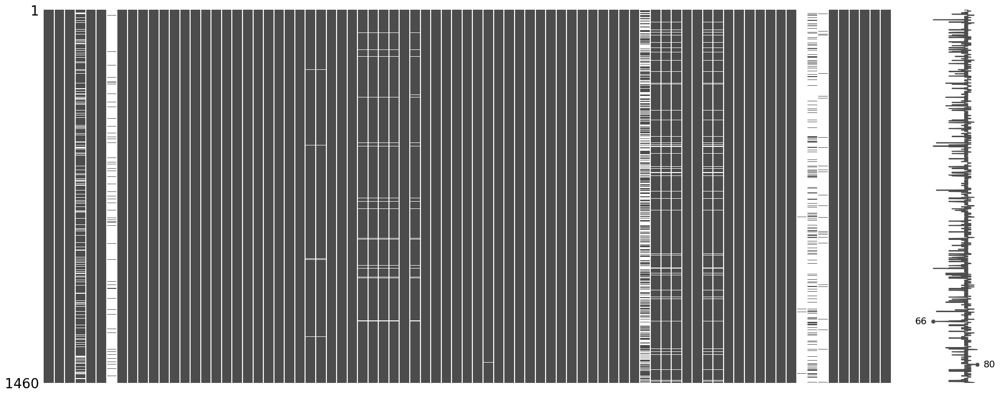

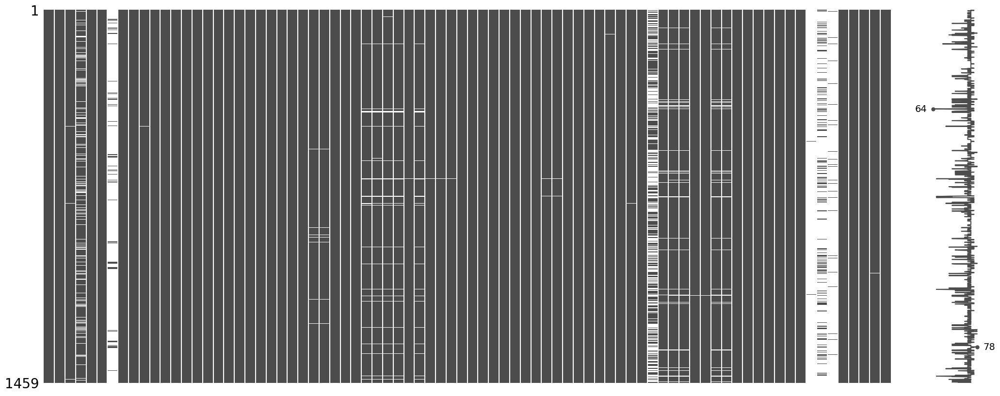

In [28]:
###### missing data visualization #################################
msno.matrix(main_df, color = (0.3, 0.3, 0.3))
msno.matrix(test_df, color = (0.3, 0.3, 0.3))

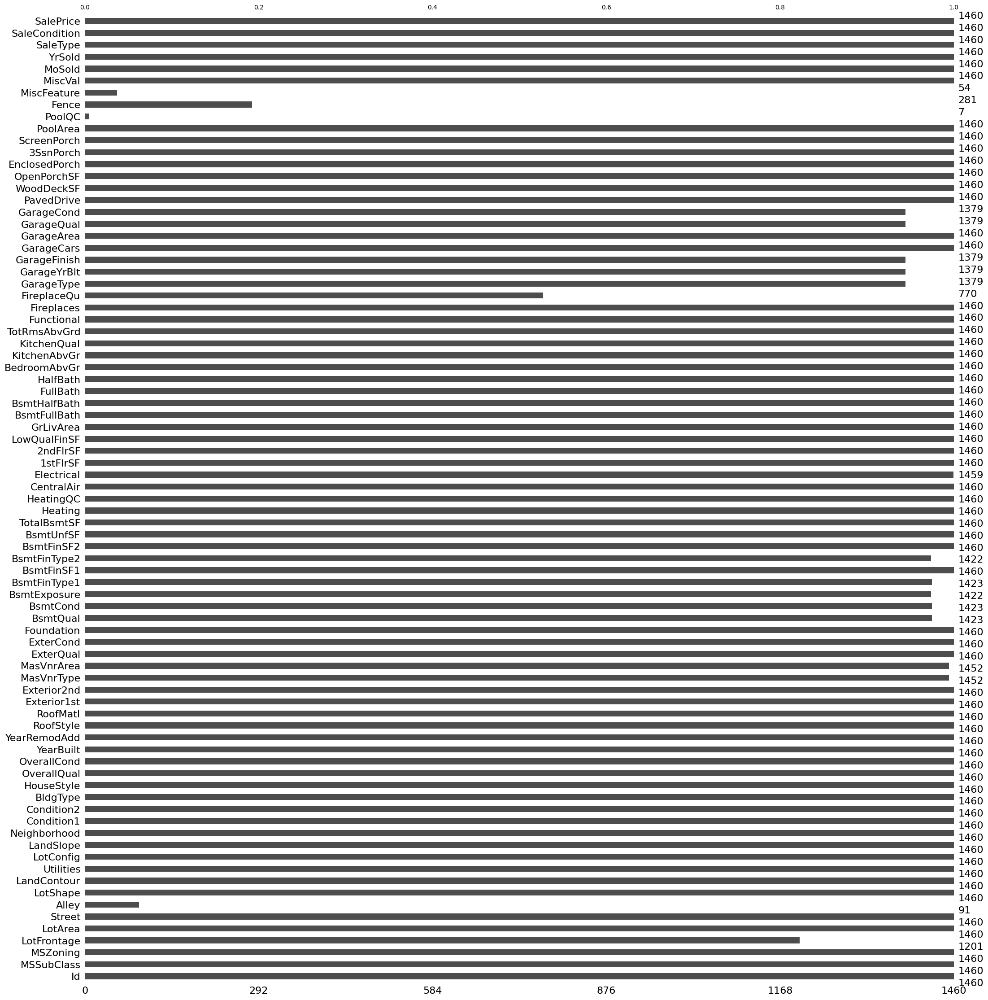

In [29]:
msno.bar(main_df, color = (0.3, 0.3, 0.3));

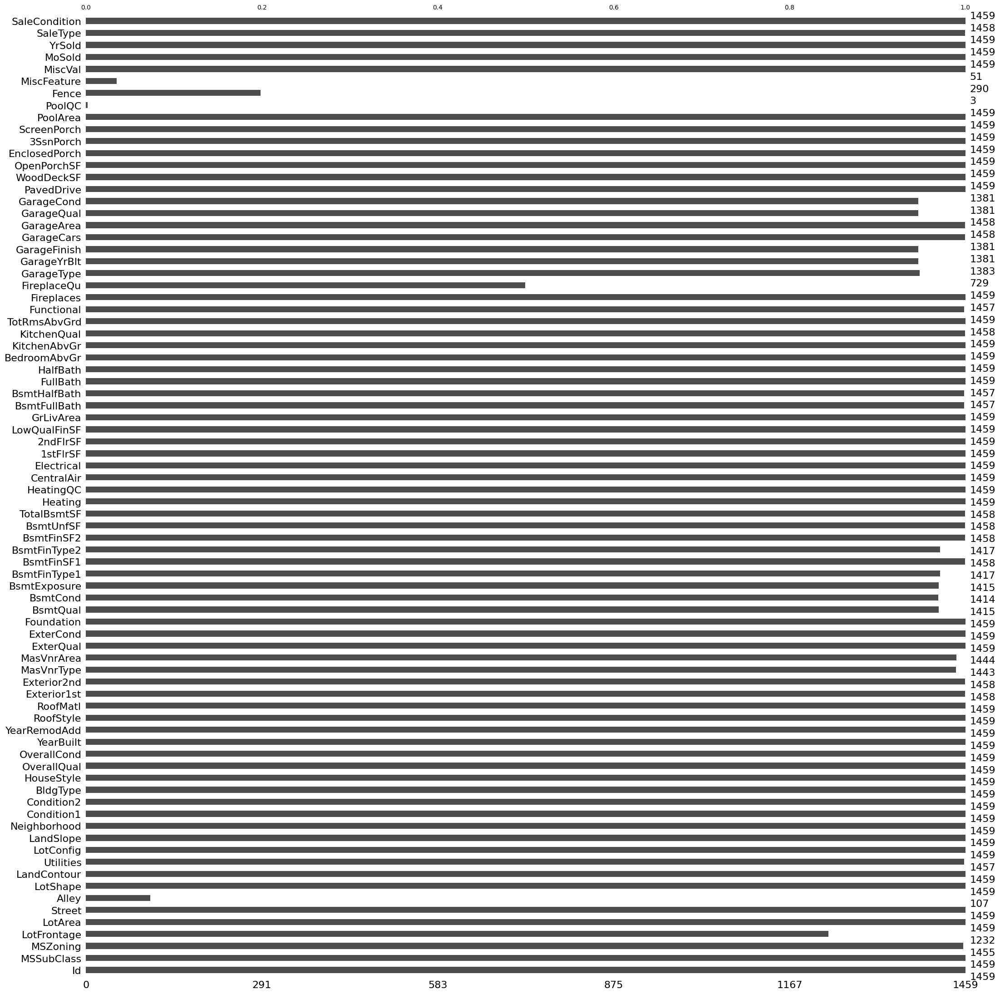

In [30]:
msno.bar(test_df, color = (0.3, 0.3, 0.3));

In [31]:
###### missing data summary ##############################
missing_data_summarize(main_df)

,missing_data_percentage,missing_entry,dtype
PoolQC,99.520548,1453,object
MiscFeature,96.301370,1406,object
Alley,93.767123,1369,object
Fence,80.753425,1179,object
FireplaceQu,47.260274,690,object
LotFrontage,17.739726,259,float64
GarageType,5.547945,81,object
GarageYrBlt,5.547945,81,float64
GarageFinish,5.547945,81,object
GarageQual,5.547945,81,object


In [32]:
missing_data_summarize(test_df)

,missing_data_percentage,missing_entry,dtype
PoolQC,99.794380,1456,object
MiscFeature,96.504455,1408,object
Alley,92.666210,1352,object
Fence,80.123372,1169,object
FireplaceQu,50.034270,730,object
LotFrontage,15.558602,227,float64
GarageCond,5.346127,78,object
GarageYrBlt,5.346127,78,float64
GarageQual,5.346127,78,object
GarageFinish,5.346127,78,object


In [34]:
missing_data_compare(df1 = main_df, df2 = test_df)


18 features with missing data in both df1 and df2:

 ['PoolQC', 'MiscFeature', 'Alley', 'Fence', 'FireplaceQu', 'LotFrontage', 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond', 'BsmtExposure', 'BsmtFinType2', 'BsmtFinType1', 'BsmtCond', 'BsmtQual', 'MasVnrArea', 'MasVnrType']


1 features with missing data in only df1:

 ['Electrical']


15 features with missing data in only df2:

 ['MSZoning', 'BsmtFullBath', 'BsmtHalfBath', 'Functional', 'Utilities', 'GarageCars', 'GarageArea', 'TotalBsmtSF', 'KitchenQual', 'BsmtUnfSF', 'BsmtFinSF2', 'BsmtFinSF1', 'Exterior2nd', 'Exterior1st', 'SaleType']




In [35]:
###### single feature zoom in ##################################
single_feature_describe('OverallQual', df=main_df, text_description=True)

feature description from data_description.txt:

OverallQual: Rates the overall material and finish of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average
       5	Average
       4	Below Average
       3	Fair
       2	Poor
       1	Very Poor
	


unique value counts in the data frame: 

5     397
6     374
7     319
8     168
4     116
9      43
3      20
10     18
2       3
1       2
Name: OverallQual, dtype: int64

missing data percentage:  0.00 %

number of missing entires: 0


### summary of 2.1
- missing data exists in both train.csv and test.csv
- some features do not have missing values in train.csv but have missing values in test.csv, and vise versa
- a specific categorical feature in train.csv may not contain all possible categories for this feature (according to data_description.txt), thus may have different category set than that in test.csv.


*back to [content outline](#0)*

<a name="2.2"></a>
## 2.2 Preliminary Data Manipulation
- [2.2.0 data type overview](#2.2.0)
- [2.2.1 missing data](#2.2.1)  
  handle missing data according to data_description.txt: both train.csv and test.csv  
  - fill missing data if NA has specific meaning for a feature  
  - missing data imputation
- [2.2.2 drop features](#2.2.2)   
  drop some features: Id, features with little information
- [2.2.3 data type transformation](#2.2.3)   
  data type transform (numerical to categorical, etc.): both train.csv and test.csv
- [2.2.4 cardinality comparison of categorical features](#2.2.4)   
  cardinality comparison of categorical features in train.csv and test.csv: preparation for feature engineering
- [2.2.5 outliers](#2.2.5)   
  remove outliers in train.csv


*back to [2. Whole Picture of Data](#2)*   
*back to [content outline](#0)*

<a name="2.2.0"></a>
## 2.2.0 data type overview

In [36]:
###### copy original main_df and test_df ##################################
dat_main = main_df.copy()
dat_test = test_df.copy()

According to data documentation http://ww2.amstat.org/publications/jse/v19n3/decock.pdf, in the original dataset (train.csv), there are  
- **23 nominal variables**  
- **23 ordinal variables**  
- **14 discrete (including 4 time series variables represented by year) variables**  
- **20 continuous variables** 
- **1 identifier**  

**First create a dictionary to map variables with corresponding variable types**.

In [37]:
###### dictionary for variable segmentation ################
var_type_dict = {'identifier': ['Id'],
                 'nominal'   : ['MSSubClass', 'MSZoning', 'Street', 'Alley', 'LandContour', 'LotConfig', 
                                'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 
                                'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'Foundation', 'Heating', 
                                'CentralAir', 'GarageType', 'MiscFeature', 'SaleType', 'SaleCondition'], 
                 'ordinal'   : ['LotShape', 'Utilities', 'LandSlope', 'OverallQual', 'OverallCond', 'ExterQual', 
                                'ExterCond', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 
                                'HeatingQC', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageFinish', 
                                'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence'], 
                 'discrete'  : ['BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 
                                'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', 'MoSold'], 
                 'year'      : ['YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold'], 
                 'continuous': ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 
                                'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'GarageArea', 
                                'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 
                                'MiscVal', 'SalePrice']}

<a name="2.2.1"></a>
## 2.2.1 missing data
According to data_description.txt, missing values of some features have specific meaning.  
For example, NA in PoolQC means 'No Pool'. 

- First fill missing data with specific meanings based on data_description.txt
- Then further fill missing data by imputation

#### missing data with specific meaning:

In [38]:
###### list of features with specific NA meanings #################
## categorical features in both dat_main and tat_test
feas_na_replace = ['Alley', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'FireplaceQu', 
                   'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence', 'MiscFeature']

## numerical features where missing values can be replaced accroding to the meaning of their related features 
## (only in dat_test),
# eg. in dat_test, missing values of numerical feature 'BsmtFullBath' can be filled with 0, as no basement 
# indicated by 'BsmtQual'
feas_na_replace_only_test = ['BsmtFullBath', 'BsmtHalfBath', 'GarageCars', 'GarageArea', 'TotalBsmtSF', 'BsmtUnfSF', 
                             'BsmtFinSF2', 'BsmtFinSF1']

In [39]:
###### fill missing data with specific meanings in dat_main and dat_test ################################
dat_main = missing_relpace(dat_main, feas_na_replace, feas_na_replace_only_test)
dat_test = missing_relpace(dat_test, feas_na_replace, feas_na_replace_only_test)

In [40]:
###### check and compare data frames' missing values again ########################
missing_data_compare(dat_main, dat_test)
missing_data_summarize(dat_main)
# missing_data_summarize(dat_test)


4 features with missing data in both df1 and df2:

 ['LotFrontage', 'GarageYrBlt', 'MasVnrType', 'MasVnrArea']


1 features with missing data in only df1:

 ['Electrical']


7 features with missing data in only df2:

 ['MSZoning', 'Utilities', 'Functional', 'Exterior1st', 'Exterior2nd', 'KitchenQual', 'SaleType']




,missing_data_percentage,missing_entry,dtype
LotFrontage,17.739726,259,float64
GarageYrBlt,5.547945,81,float64
MasVnrType,0.547945,8,object
MasVnrArea,0.547945,8,float64
Electrical,0.068493,1,object


#### missing data imputation:

**4 features for imputation in both `dat_main` and `dat_test`:**
- **`MasVnrType`:** fill with mode in main_df ('None')
- **`MasVnrArea`:** fill with 0, since most records with 'None' MasVnrType have `MasVnrArea` value equal to 0
- **`LotFrontage`:** impute with the LotFrontage median of corresponding `Neighborhood` in main_df
- **`GarageYrBlt`:** keep the missing data for now

**1 features in `dat_main`:**
- **`Electrical`:** fill with mode in main_df

**7 features in `dat_test` (all categorical):**
- for **`MSZoning`, `Functional`, `Exterior1st`, `Exterior2nd`, `KitchenQual`, `SaleType`:** fill with feature's mode in main_df
- **`Utilities`:** no need for imputation, drop the feature


In [41]:
###### missing data imputation ########################

## list of features for further imputation:
feas_na_imputate = ['MasVnrType', 'MasVnrArea', 'LotFrontage', 'MSZoning', 'Functional', 'Exterior1st', 'Exterior2nd', 
                    'KitchenQual', 'Electrical', 'SaleType']

### call function missing_imputate() for further imputation
dat_main = missing_imputate(dat_main, feas_na_imputate)
dat_test = missing_imputate(dat_test, feas_na_imputate)


*back to [2.2 Preliminary Data Manipulation](#2.2)*

<a name="2.2.2"></a>
## 2.2.2 drop features
**drop feature 'Id' and 'Utilities'**

- `Utilities`: 
  - in dat_test, except for 2 NA values, all records have 'AllPub' for this feature; 
  - in dat_main, all  records except one have value 'AllPub' for this feature;  
  - this implies there's little information provided by this feature

- `Id`: idendifier feature does not providde useful information

In [42]:
###### drop feature 'Id' and 'Utilities' ############################
dat_main = dat_main.drop(['Id', 'Utilities'], axis = 1)
dat_test = dat_test.drop(['Id', 'Utilities'], axis = 1)

In [43]:
###### check the data frames again ###########################
missing_data_summarize(dat_main)
missing_data_summarize(dat_test)

,missing_data_percentage,missing_entry,dtype
GarageYrBlt,5.346127,78,float64


*back to [2.2 Preliminary Data Manipulation](#2.2)*

<a name="2.2.3"></a>
## 2.2.3 data type transformation

- basic data type transformation based on var_type_dict (numerical to categorical, etc.):  


In [44]:
###### transform feature MSSubClass from numerical to categorical #######################################
### MSSubClass is a nominal categorical feature with dtype int
dat_main['MSSubClass'] = dat_main['MSSubClass'].apply(str)
dat_test['MSSubClass'] = dat_test['MSSubClass'].apply(str)

<a name="2.2.4"></a>
## 2.2.4 cardinality comparison of categorical features

Categorical features in train.csv may have different category set from those in test.csv, which can later on cause problems in feature engineering, specifically in categorical feature ordinal/onehot encoding step.  
- a categorical feature needs to be handled before encoding if: the feature's categorical set in train.csv does not **match/include** that in test.csv

**Here cardinality comparison is made for all categorical features from train.csv (dat_main) and test.csv (dat_test).**

In [45]:
###### use function cat_feat_check() to check whether the feature's categorical set in dat_main
###### match/include that in dat_test ################
cat_feat_lst = var_type_dict['ordinal'] + var_type_dict['nominal']
cat_feat_lst.remove('Utilities')

feat_match_lst, feat_no_match_lst = cat_feat_check(dat_main, dat_test, cat_feat_lst)

print('Features from train.csv that match/include all categories of their '
      'corresponding features from test.csv:\n\n{}'.format(feat_match_lst))
print('\n\nFeatures from train.csv that **DO NOT** match/include all categories of '
      'their corresponding features from test.csv:\n\n{}'.format(feat_no_match_lst))


Features from train.csv that match/include all categories of their corresponding features from test.csv:

['LotShape', 'LandSlope', 'OverallQual', 'OverallCond', 'ExterQual', 'ExterCond', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'HeatingQC', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MSZoning', 'Street', 'Alley', 'LandContour', 'LotConfig', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'Foundation', 'Heating', 'CentralAir', 'GarageType', 'MiscFeature', 'SaleType', 'SaleCondition']


Features from train.csv that **DO NOT** match/include all categories of their corresponding features from test.csv:

['MSSubClass']


#### **conclusion**: 
**only feature `MSSubClass` does not meet the condition.**  
Further check this feature's cardinality in train.csv and test.csv:

In [50]:
single_feature_describe('MSSubClass', df = dat_main)
print('\n' + '*' * 50 + '\n')
single_feature_describe('MSSubClass', df = dat_test, text_description = False)

feature description from data_description.txt:

MSSubClass: Identifies the type of dwelling involved in the sale.	

        20	1-STORY 1946 & NEWER ALL STYLES
        30	1-STORY 1945 & OLDER
        40	1-STORY W/FINISHED ATTIC ALL AGES
        45	1-1/2 STORY - UNFINISHED ALL AGES
        50	1-1/2 STORY FINISHED ALL AGES
        60	2-STORY 1946 & NEWER
        70	2-STORY 1945 & OLDER
        75	2-1/2 STORY ALL AGES
        80	SPLIT OR MULTI-LEVEL
        85	SPLIT FOYER
        90	DUPLEX - ALL STYLES AND AGES
       120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
       150	1-1/2 STORY PUD - ALL AGES
       160	2-STORY PUD - 1946 & NEWER
       180	PUD - MULTILEVEL - INCL SPLIT LEV/FOYER
       190	2 FAMILY CONVERSION - ALL STYLES AND AGES



unique value counts in the data frame: 

20     536
60     299
50     144
120     87
30      69
160     63
70      60
80      58
90      52
190     30
85      20
75      16
45      12
180     10
40       4
Name: MSSubClass, dtype: int64

m

**From the above summary, it shows that `MSSubClass` does not have category '150' in train.csv, while has only 1 '150' record in test.csv.**  
Since `MSSubClass` is a nominal feature, one way to solve the problem is to combine less frequent categories, the other way is to invlove some extra work to take care of this feature in one-hot encoding step of feature engineering phase.

*back to [2.2 Preliminary Data Manipulation](#2.2)*

<a name="2.2.5"></a>
## 2.2.5 outliers
According to the dateset documentation http://jse.amstat.org/v19n3/decock.pdf, there are **five unusual observations** which most likely are outliers.
- a plot of `SalePrice` vs `GrLivArea` will quickly indicate these points
- these 5 outliers can be identified by searching records with `GrLivArea` more than 4000 in the dataset
- there are **4 outliers in dat_main (train.csv) and 1 outlier in dat_test (test.csv)**

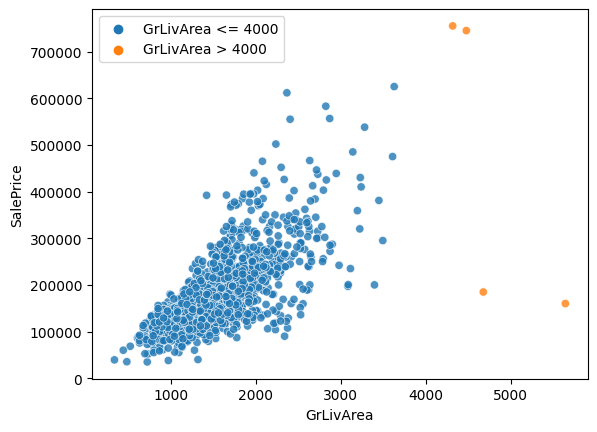

In [51]:
###### visualize outliers by plotting correlation between SalePrice and GrLivArea ###################
fig, ax = plt.subplots()
sns.scatterplot(x = 'GrLivArea', y = 'SalePrice', data = dat_main, 
                alpha = 0.8, hue = dat_main.GrLivArea > 4000)
plt.ylabel('SalePrice')
plt.xlabel('GrLivArea')
legend = ax.legend()
for text in legend.texts:
    if text.get_text() == 'False': 
        text.set_text('GrLivArea <= 4000')
    else:
        text.set_text('GrLivArea > 4000')
plt.show()

#### conclusion:
As recommended by the author of the dataset documentation, any record with feature `GrLivArea` more than 4000 will be removed, but only from dat_main (train.csv). The single one potential outlier in dat_test (test.csv) will still be kept.

In [52]:
###### remove outliers in dat_main (train.csv) ################################
dat_main = dat_main[dat_main.GrLivArea <= 4000]

### summary of 2.2 

#### data manipulation completed in 2.2
- all missing data handled (filled/imputed) except `GarageYrBlt`
- data type transformation for feature `MSSubClass` (int to str)
- remove feature `Id` and `Utilities`
- remove 4 outliers from (dat_main) train.csv
- notes: original datasets are stored in `main_df` and `test_df`, datasets after basic manipulation are stored in `dat_main` and `dat_test`

#### Problems remaining to be solved:
- currently only one feature `GarageYrBlt` has missing values in both dat_main and dat_test, these missing values need to be filled.  
- unmatched categories for feature `MSSubClass` in dat_main and dat_test: category binning to solve the problem.

*back to [2. Whole Picture of Data](#2)*      
*back to [content outline](#0)*

<a name="3"></a>
# 3. Univariate Analysis
Single variable analysis based on datatype, explore relationship between a single feature and target variable `SalePrice`. Focus on data in train.csv to get as much information as possible out of training data.
- [3.0 Updated Feature Type Segmentation](#3.0)
- [3.1 Response / Target Variable](#3.1)
- [3.2 Numerical Features](#3.2)
  - year-related features
  - discrete features
  - continuous features
- [3.3 Categorical Features](#3.3)
- **numerical features**: year-related, discrete, continuous
- **categorical features**: nominal, ordinal

<a name="3.0"></a>
## 3.0 Updated Feature Type Segmentation

since two features, `Id` and `Utilities`, were removed from the data, and target variable `SalePrice` is analized separately, an updated dictionary for feature type segmentation will be used.

In [53]:
###### an updated dictionary for feature type segmentation ################
feat_type_dict= {}
for key in ['nominal', 'ordinal', 'discrete', 'year', 'continuous']:
    if key == 'ordinal':
        feat_type_dict[key] = [feat for feat in var_type_dict[key] if feat != 'Utilities']
    elif key == 'continuous':
        feat_type_dict[key] = [feat for feat in var_type_dict[key] if feat != 'SalePrice']
    else:
        feat_type_dict[key] = var_type_dict[key]

###### print feat_type_dict: import json ########################################################
print(json.dumps(feat_type_dict, indent=2, default=str))

{
  "nominal": [
    "MSSubClass",
    "MSZoning",
    "Street",
    "Alley",
    "LandContour",
    "LotConfig",
    "Neighborhood",
    "Condition1",
    "Condition2",
    "BldgType",
    "HouseStyle",
    "RoofStyle",
    "RoofMatl",
    "Exterior1st",
    "Exterior2nd",
    "MasVnrType",
    "Foundation",
    "Heating",
    "CentralAir",
    "GarageType",
    "MiscFeature",
    "SaleType",
    "SaleCondition"
  ],
  "ordinal": [
    "LotShape",
    "LandSlope",
    "OverallQual",
    "OverallCond",
    "ExterQual",
    "ExterCond",
    "BsmtQual",
    "BsmtCond",
    "BsmtExposure",
    "BsmtFinType1",
    "BsmtFinType2",
    "HeatingQC",
    "Electrical",
    "KitchenQual",
    "Functional",
    "FireplaceQu",
    "GarageFinish",
    "GarageQual",
    "GarageCond",
    "PavedDrive",
    "PoolQC",
    "Fence"
  ],
  "discrete": [
    "BsmtFullBath",
    "BsmtHalfBath",
    "FullBath",
    "HalfBath",
    "BedroomAbvGr",
    "KitchenAbvGr",
    "TotRmsAbvGrd",
    "Fireplaces",
    

*back to [3. Univariate Analysis](#3)*      
*back to [content outline](#0)*

<a name="3.1"></a>
## 3.1 Response / Target Variable
The variable that needs to be predicted is `SalePrice`. First call customized function `plot_numerical_var()` to visualize the target variable.

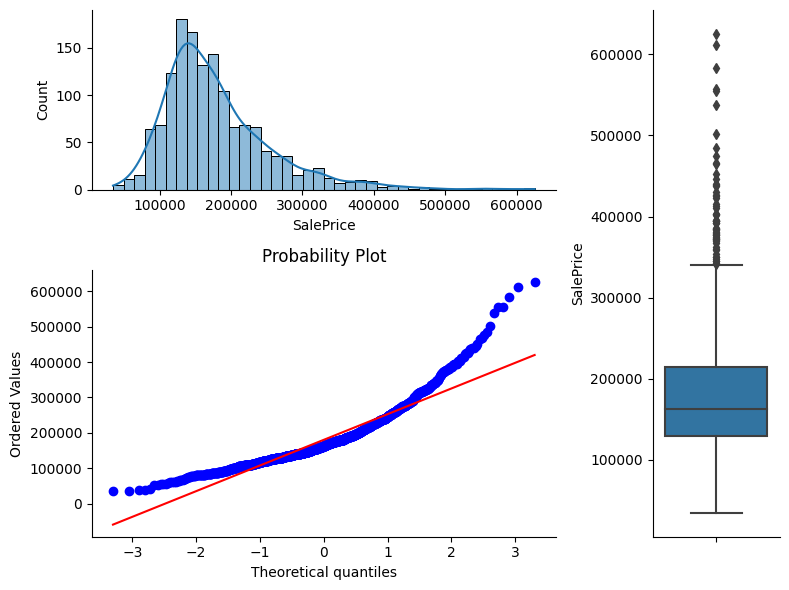

In [54]:
plot_numerical_var(df = dat_main, feature = 'SalePrice')

#### observation:
As shown from the result, the target variable is right skewed compared with normal distribution. All the upcoming linear regression models require at leat nearly normal-distributed response variable, thus transformation is needed to make it more normal-distributed.

**Log transformation is used on target variable `SalePrice`, then apply the plot function again.**

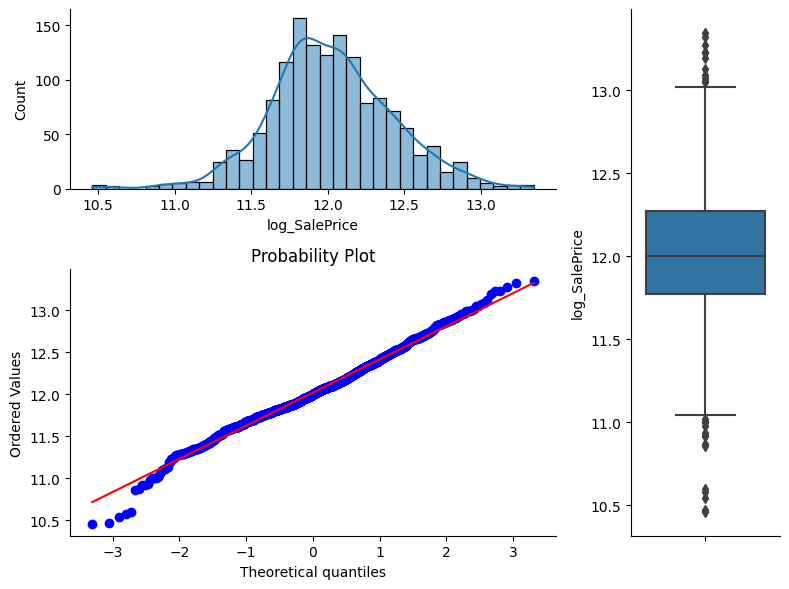

In [55]:
temp_df = dat_main.copy()
temp_df['log_SalePrice'] = np.log(temp_df['SalePrice'])
plot_numerical_var(df = temp_df, feature = 'log_SalePrice')

### summary of 3.1
- use log transformation on target variables for linear regression model training


*back to [3. Univariate Analysis](#3)*      
*back to [content outline](#0)*

<a name="3.2"></a>
## 3.2 Numerical Features
- [3.2.1 year-related features](#3.2.1)   
  4 year-related features
- [3.2.2 discrete numerical features](#3.2.2)   
  10 discrete features
- [3.2.3 continuous numerical features](#3.2.3)   
  20 continuous features

- **notes**: since log transformation will be applied on target variable, all corrlation involving feature vs. target will be using **log_SalePrice**.

<a name="3.2.1"></a>
## 3.2.1 year-related features
- feature `GarageYrBlt` has missing data, figure out a way for imputation
- relationship of each feature vs. **log target** variable
- explore generating new features

first check linear relationship of each feature vs. log_SalePrice, correlation coefficients for each relationship are also shown in the plots:   
**two types of correlation coefficients** are provided:  
- **Pearson** correlation coefficient (represented by **ρ** in plots): linear relationship
- **Spearman** correlation coefficient (represented by **r** in plots): monotonic relationship, works even when the features are discrete / ordered categorical


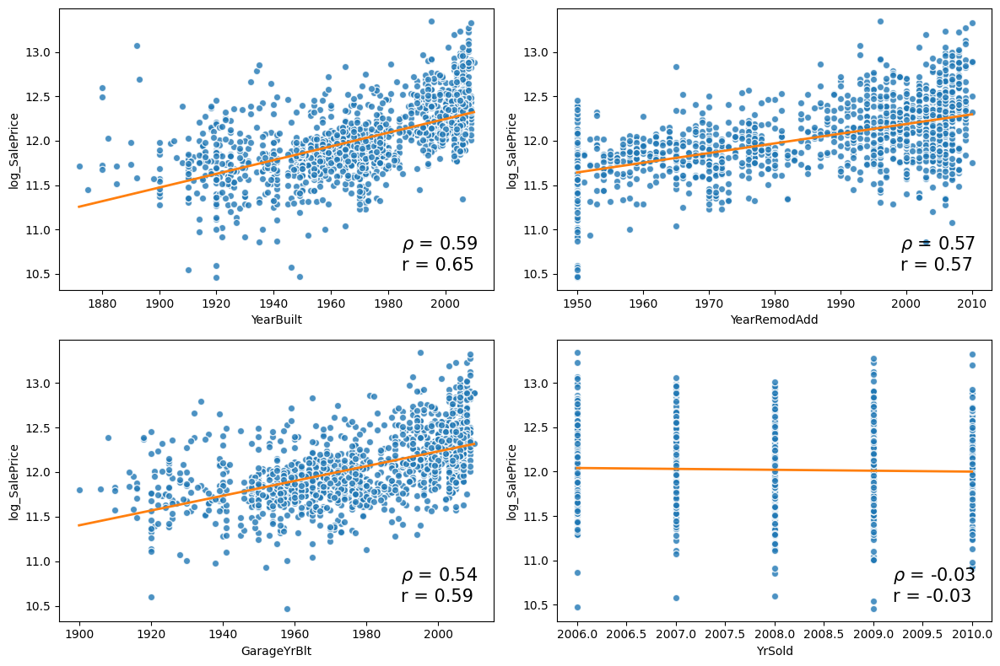

In [56]:
plot_feat_target(df = temp_df, feat_lst = feat_type_dict['year'], target_var = 'log_SalePrice', 
                 kind = 'regplot', show_corr=True)

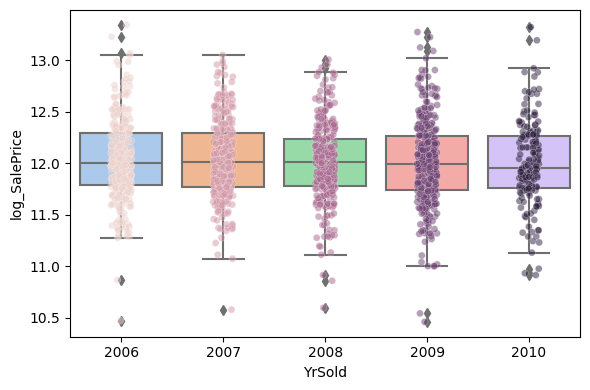

In [57]:
###### YrSold vs. log_SalePrice ################################
plot_feat_target(df = temp_df, feat_lst = ['YrSold'], target_var = 'log_SalePrice', 
                 kind = 'box_strip')

**Observation**:
- The regression line for `YrSold` vs `log_SalePrice` is almost flat. Therefore, there isn't too much useful information in this single feature `YrSold` for SalePrice prediction.
- create new features by subtracting other year-related features from `YrSold`

In [58]:
###### create new features #######################
temp_df['AgebySale'] = temp_df['YrSold'] - temp_df['YearBuilt'] # house age at sale
temp_df['GarageAge'] = temp_df['YrSold'] - temp_df['GarageYrBlt'] # garage age at sale
temp_df['RemodAge'] = temp_df['YrSold'] - temp_df['YearRemodAdd'] # remodel age at sale

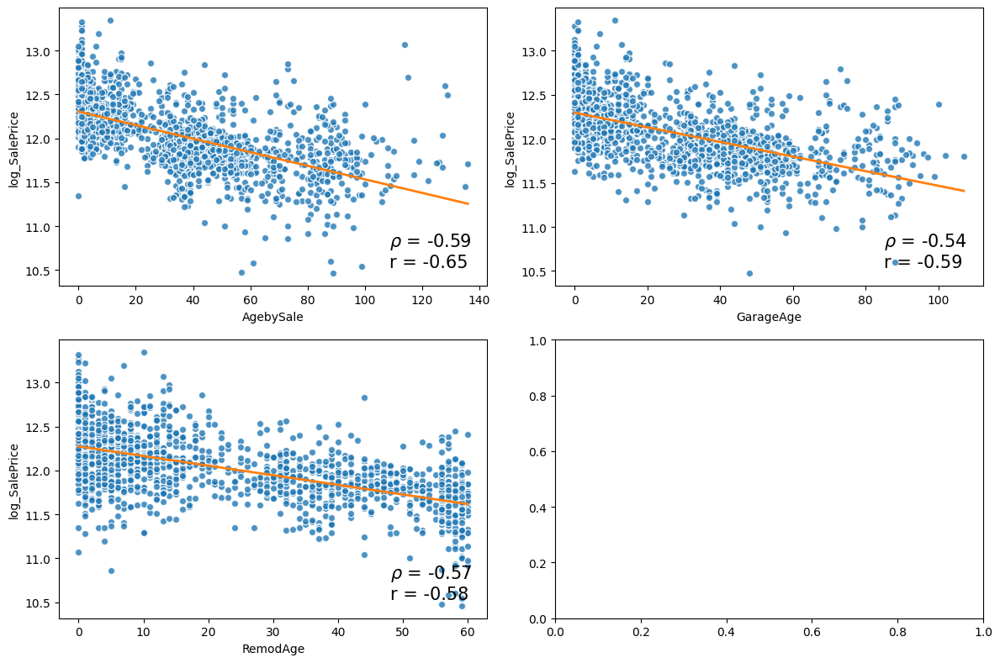

In [59]:
###### new feature vs. log_SalePrice #############################
new_year_feat_lst = ['AgebySale', 'GarageAge', 'RemodAge']
plot_feat_target(df = temp_df, feat_lst = new_year_feat_lst, target_var = 'log_SalePrice', 
                 kind = 'regplot', show_corr=True)

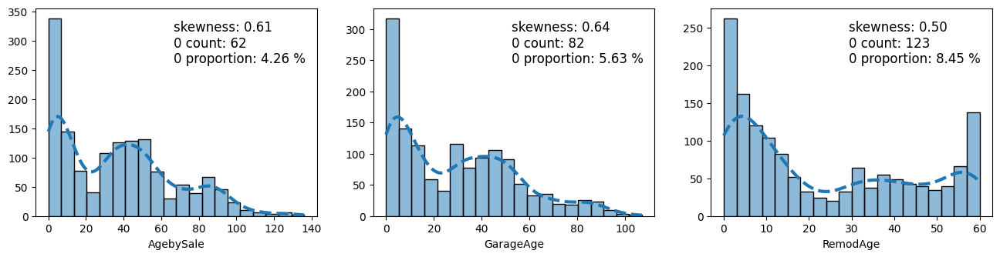

In [60]:
###### histogram matrix of new features using function plot_hist_matrix() ##############################
plot_hist_matrix(temp_df, new_year_feat_lst)

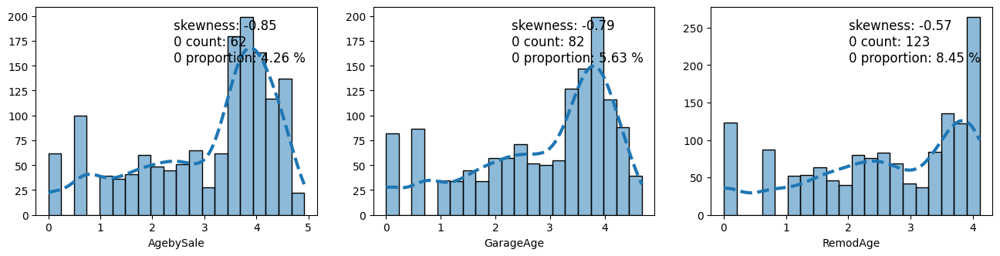

In [61]:
###### histogram matrix after applying log1p transformation #########################################
plot_hist_matrix(temp_df[new_year_feat_lst].apply(np.log1p), new_year_feat_lst)

**observation and summary:**
- skewness gets worse than original after log1p transformation
- just keep the new created features as original, only use scaling in feature enginerring, no log1p transformation

**Since `GarageAge` is created from `GarageYrBlt`, which has missing data, next figure out method for `GarageAge` imputation.**

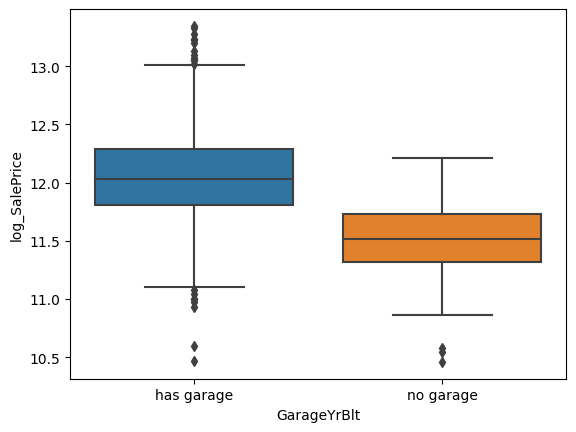

In [62]:
###### boxplot: GarageYrBlt vs log_SalePrice ##################################################
## missing values of `GarageYrBlt` and `GarageAge` mean 'no garage'
sns.boxplot(x = temp_df['GarageYrBlt'].notna().astype('int64').replace({0: 'no garage', 1: 'has garage'}), 
            y = temp_df['log_SalePrice']);

**Observation**:
- `GarageAge` = `YrSold` - `GarageYrBlt`
- missing values in `GarageAge` means no garage
- from boxplot, it shows that on average price of most houses without garage is below the price of houses with garage
- from regplot, low `log_SalePrice` corresponds to large `GarageAge` value
- in summary, missing values in `GarageAge` correspond to lower `log_SalePrice`, which are supposed to have relatively larger `GarageAge` values, thus the missing values of GarageAge need to be set as large as possible to reflect the above observations, which are at most the value of `AgebySale`
#### impute missing values of `GarageAge` with corresponding `AgebySale` values

In [63]:
###### GarageAge missing value imputation ###############################
### impute with 'AgebySale'
temp_df['GarageAge'] = temp_df.apply(lambda row: row['AgebySale'] if np.isnan(row['GarageAge']) else row['GarageAge'], axis = 1)

### Summary of 3.2.1
#### feature analysis
- original 4 year-related features (has NaN values in `GarageYrBlt`) --> 3 new created age-related features: `new_year_feat_lst`
- skewness of new features all below 0.7, log1p transformation does not improve skewness, so **WILL NOT** use log1p transformation
- imputate NaN values of new feature `GarageAge` with corresponding values of `AgebySale`

#### feature engineering steps for year-related features
- create 3 features (**NO** log1p transformation)
- drop 4 original features
- imputate missing values of new feature `GarageAge` with corresponding `AgebySale` values  
- MinMax Scaling


*back to [3.2 Numerical Features](#3.2)*      

<a name="3.2.2"></a>
## 3.2.2 discrete numerical features
- relationship of each feature vs. **log target** variable
- check linear/monotonic relationship
- for linear regression need, try feature range binning when monotonic relationship is not shown or not obvious between `log_SalePrice` and the feature (mentioned in dataset documentation by creator)
- some features may have different min-max range or discrete set between train.csv and test.csv (`TotRmsAbvGrd`)
- explore creating new features

In [64]:
print('\ndiscrete numerical features:\n\n{}'.format(feat_type_dict['discrete']))


discrete numerical features:

['BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', 'MoSold']


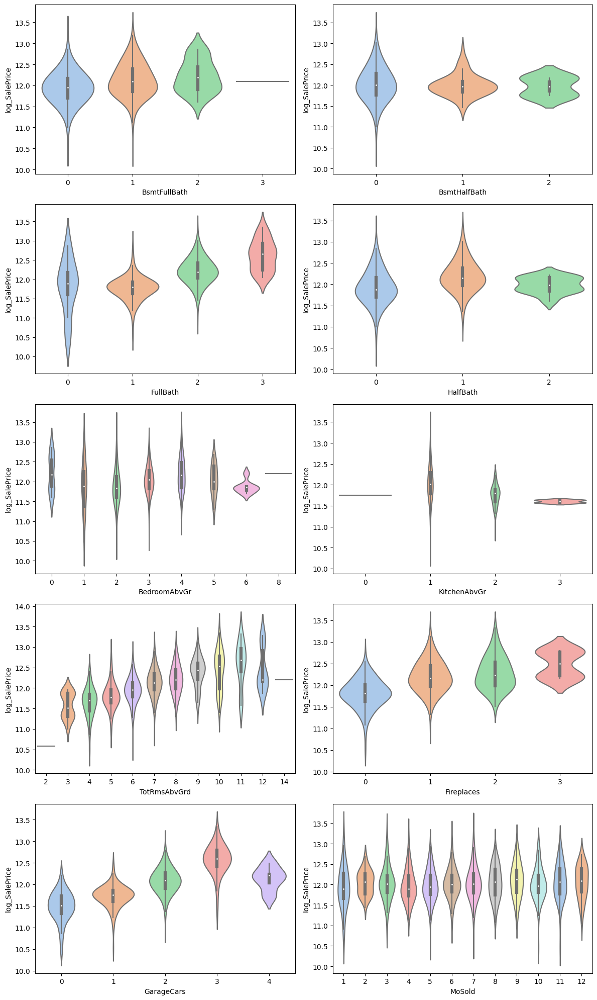

In [65]:
###### feature vs. log_SalePrice: violinplot #############################
plot_feat_target(df = temp_df, feat_lst = feat_type_dict['discrete'], target_var = 'log_SalePrice', kind = 'violin')

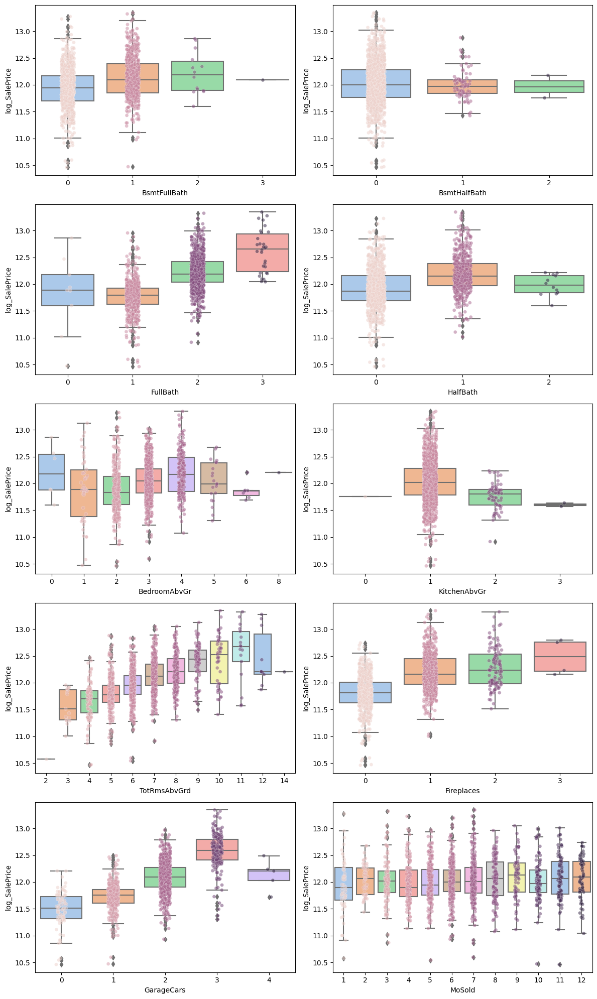

In [66]:
###### feature vs. log_SalePrice: box_strip plot #############################
plot_feat_target(df = temp_df, feat_lst = feat_type_dict['discrete'], target_var = 'log_SalePrice', kind = 'box_strip')

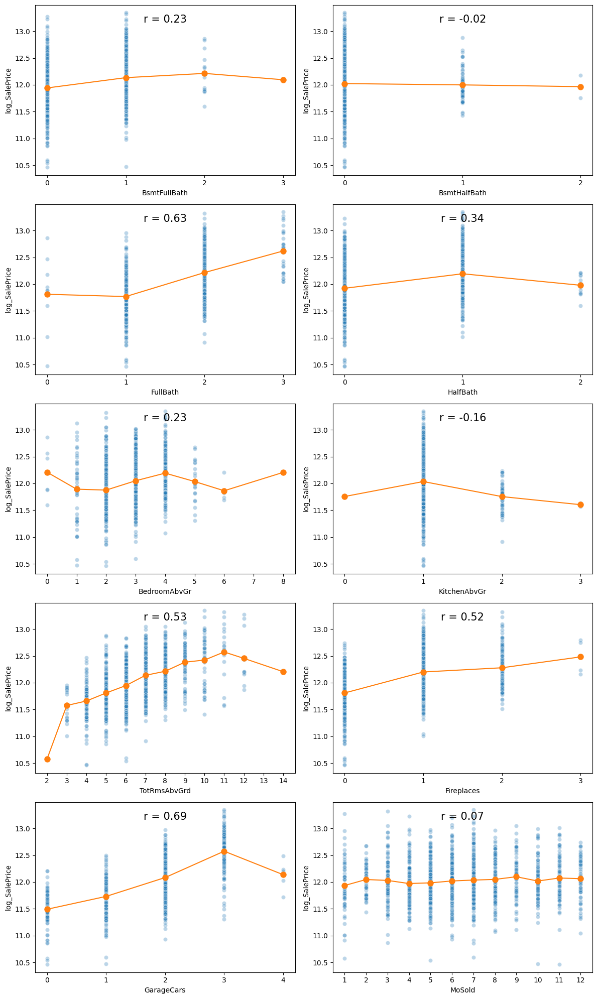

In [67]:
###### feature vs. log_SalePrice: pointplot + scatterplot #############################
plot_feat_target(df = temp_df, feat_lst = feat_type_dict['discrete'], 
                 target_var = 'log_SalePrice', kind = 'point_scatter', show_corr=True)

#### plot interpretation:  
- scatter plot roughly shows the number of records that belong to each discrete value
- line plot connects the mean point for each group

#### observation:
- for some features, certain categories may have much fewer observations than the other categories
- linear/monotonic relationship with `log_SalePrice` does not exist for some features: 
- linear/monotonic relationship with `log_SalePrice` is not obvious for some features:

#### try range binning (for linear regression need):
- `BsmtFullBath`: --> bin_BsmtFullBath: 0 | 1,2,3 (has BsmtFullBath?) **different from 'has basement'**
- `BsmtHalfBath`: --> bin_BsmtHalfBath: 0 | 1,2 (has BsmtHalfBath?) or **drop**
- `FullBath`: --> bin_FullBath: 0,1| 2,3,(4)
- `HalfBath`: --> bin_HalfBath: 0 | 1,2 (has HalfBath?)
- `BedroomAbvGr`: --> bin_BedroomAbvGr: 0,1,2 | 3 | 4,5 ...8 (different binning???)
- `KitchenAbvGr`: --> bin_KitchenAbvGr: 0,1 | 2,3
- `TotRmsAbvGrd`: --> bin_TotRmsAbvGrd: <=4 | 5 | 6 | 7 | 8 | >= 9
- `Fireplaces`: --> bin_Fireplaces: 0 | 1 | 2,3,4
- `GarageCars`: --> bin_GarageCars: 0 | 1 | 2 | 3,4,5
- `MoSold`: --> **drop**

**goal**:
- range binning: combine less frequent & adjacent categories of a feature
- figuure out new way to reveal monotonic/linear relationships between features and target variable.

#### range bin and ordinal encoding all at once with pd.cut()

In [68]:
###### create 9 new features by binning discrete numerical features: #####################################
### binning and ordinal encoding all at once
bin_discrete_fea_lst = [feat for feat in feat_type_dict['discrete'] if feat != 'MoSold']

for feat in ['BsmtFullBath', 'BsmtHalfBath', 'HalfBath']:
    new_feat = 'bin_' + feat
    temp_df[new_feat] = pd.cut(temp_df[feat], bins=[0, 1, 5], right=False, labels=False)

for feat in ['FullBath', 'KitchenAbvGr']:
    new_feat = 'bin_' + feat
    temp_df[new_feat] = pd.cut(temp_df[feat], bins=[0, 2, 5], right=False, labels=False)

# ['BedroomAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars']
temp_df['bin_BedroomAbvGr'] = pd.cut(temp_df['BedroomAbvGr'], bins=[0, 3, 4, 10], right=False, labels=False)
temp_df['bin_TotRmsAbvGrd'] = pd.cut(temp_df['TotRmsAbvGrd'], bins=[0, 5, 6, 7, 8, 9, 20], right=False, labels=False)
temp_df['bin_Fireplaces'] = pd.cut(temp_df['Fireplaces'], bins=[0, 1, 2, 6], right=False, labels=False)
temp_df['bin_GarageCars'] = pd.cut(temp_df['GarageCars'], bins=[0, 1, 2, 3, 8], right=False, labels=False)


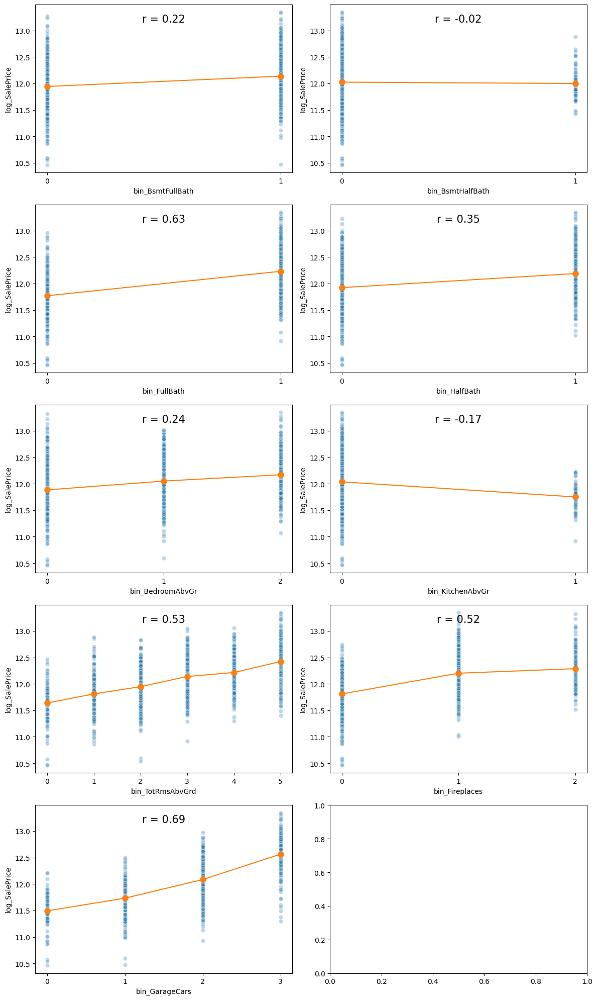

In [69]:
###### pointplot + scatterplot: new bin_feature vs. log_SalePrice: use function #############################
bin_discrete_feat_lst_new = ['bin_' + feat for feat in feat_type_dict['discrete'] if feat != 'MoSold']
plot_feat_target(df = temp_df, feat_lst = bin_discrete_feat_lst_new, 
                 target_var = 'log_SalePrice', kind = 'point_scatter', show_corr=True)

**summary and observation after binning**:
- according to the plot matrix, after binning, all newly created features show monotonic relationship with log_SalePrice
- for a specific binned feature, there is no 'rare' categories

#### create new features by feature interaction
- create feature `TotalBath`

In [70]:
###### Total number of bathrooms ###########################################
temp_df['TotalBath'] = (temp_df['BsmtFullBath'] + 0.5 * temp_df['BsmtHalfBath']
                        + temp_df['FullBath'] + 0.5 * temp_df['HalfBath'])
temp_df['TotalBath'].value_counts()

2.0    456
2.5    295
1.0    228
3.0    186
3.5    144
1.5    129
4.0     12
4.5      4
6.0      1
5.0      1
Name: TotalBath, dtype: int64

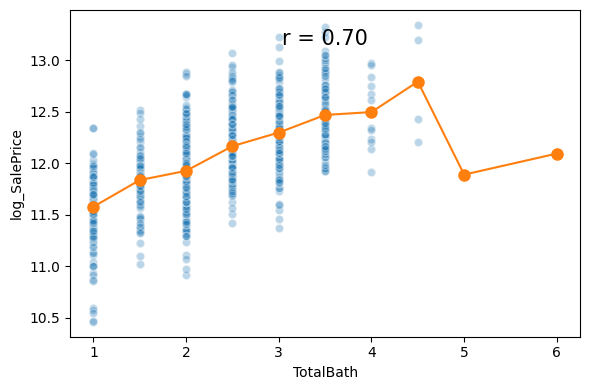

In [71]:
###### pointplot + scatterplot: new TotalBath vs. log_SalePrice #############################
plot_feat_target(df = temp_df, feat_lst = ['TotalBath'], 
                 target_var = 'log_SalePrice', kind = 'point_scatter', show_corr=True)

#### bin and ordinal encode the new feature `TotalBath`
- to strengthen monotonic relationship with `log_SalePrice` for linear regression need
- `TotalBath` --> `bin_TotalBath`: 1 | 1.5 | 2 | 2.5 | 3 | 3.5 | >= 4

In [72]:
###### bin and ordinal encode the new feature 'TotalBath' ##############################
temp_df['bin_TotalBath'] = pd.cut(temp_df['TotalBath'], bins=[1, 1.5, 2, 2.5, 3, 3.5, 4, 10], right=False, labels=False)
temp_df['bin_TotalBath'].value_counts()

2    456
3    295
0    228
4    186
5    144
1    129
6     18
Name: bin_TotalBath, dtype: int64

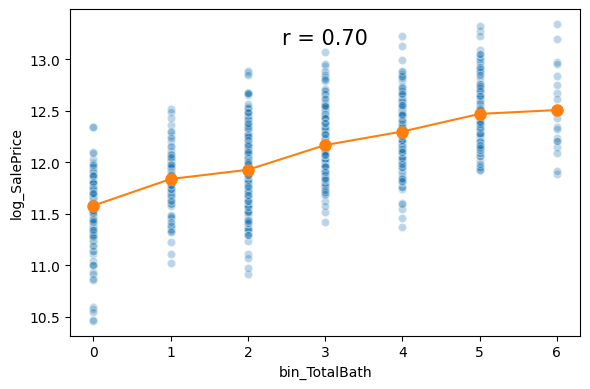

In [73]:
###### pointplot + scatterplot: bin_TotalBath vs. log_SalePrice #############################
plot_feat_target(df = temp_df, feat_lst = ['bin_TotalBath'], 
                 target_var = 'log_SalePrice', kind = 'point_scatter', show_corr=True)

### Summary of 3.2.2
#### feature analysis
- drop feature `MoSold` since the means of `log_SalePrice`  across all months seem to be stable and flat
- remaining 9 original discrete numerical features --> range bin and ordinal encode --> 9 new created features: `bin_discrete_feat_lst_new`
- create new feature `bin_TotalBath` by feature interaction, range bin, and ordinal encode

#### feature engineering steps for discrete numerical features   
- drop `MoSold`
- create 9 range-binned and ordinal encoded features: `bin_discrete_feat_lst_new`
- create new feature `bin_TotalBath` by feature interaction: interaction --> range bin --> ordinal encode
- **NO** log1p transform
- drop remaining 9 original features
- MinMax Scaling


*back to [3.2 Numerical Features](#3.2)*  

<a name="3.2.3"></a>
## 3.2.3 continuous numerical features
- [histogram matix to check skewness](#3.2.3.1)
- [check linear/monotonic relationship of each feature vs. **log target** variable](#3.2.3.2)
- [try log1p transformation and check the skewness improvement](#3.2.3.3)
- [create log1p transformed features based on the above analysis](#3.2.3.4)
- [create categorical features](#3.2.3.5)
- [create new features by feature interaction](#3.2.3.6)     

In [74]:
print('{} continuous numerical features:\n\n{}'.format(len(feat_type_dict['continuous']), 
                                                       feat_type_dict['continuous']))

19 continuous numerical features:

['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal']


<a name="3.2.3.1"></a>
#### histogram matix to check skewness

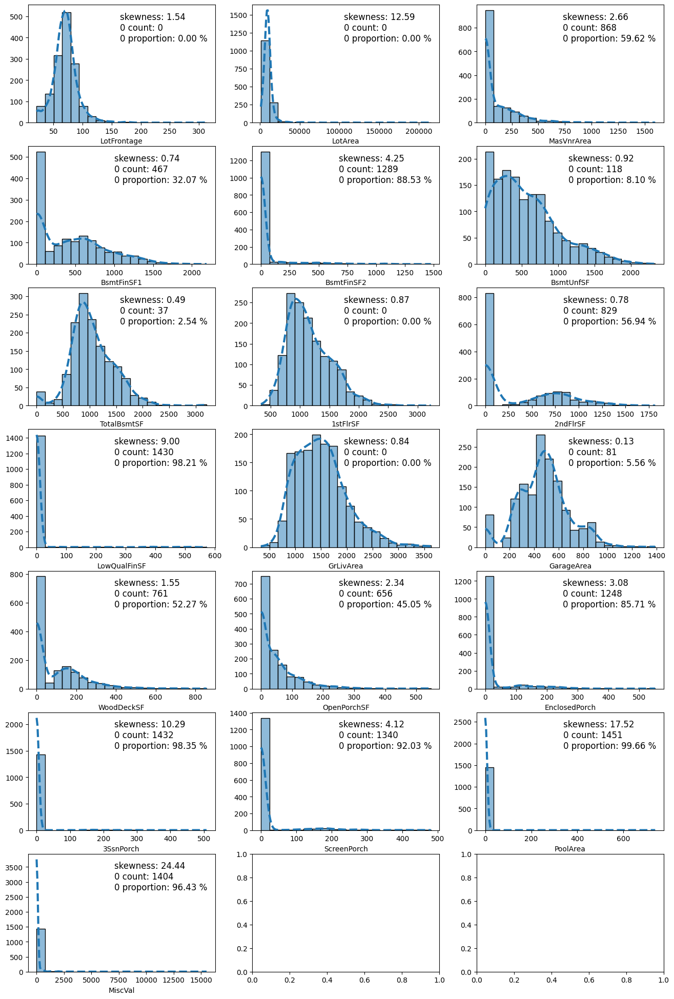

In [75]:
###### histogram matrix and skewness information of original continuous features ###############################
plot_hist_matrix(temp_df, feat_type_dict['continuous'])

#### Observation:
- some features have a lot of zero values (zero-inflated):   
  eg. `BsmtFinSF2`, `LowQualFinSF`, `EnclosedPorch`, `3SsnPorch`, `ScreenPorch`, `PoolArea`, `MiscVal`
- some features are extremely right skewed:  
  eg. `LotArea`, `MasVnrArea`, `2ndFlrSF`, `WoodDeckSF`, `OpenPorchSF`


**for features with large proportion of zeros (> 30 %), only plot histogram of non-zero value distributions for better check**

In [76]:
###### non-zero value distribution and skewness information for some features ##################################
zero_prop = temp_df[feat_type_dict['continuous']].apply(lambda col: (col == 0).mean())
non_zero_feat = zero_prop[zero_prop > 0.30].index.tolist()
print(non_zero_feat)

['MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', '2ndFlrSF', 'LowQualFinSF', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal']


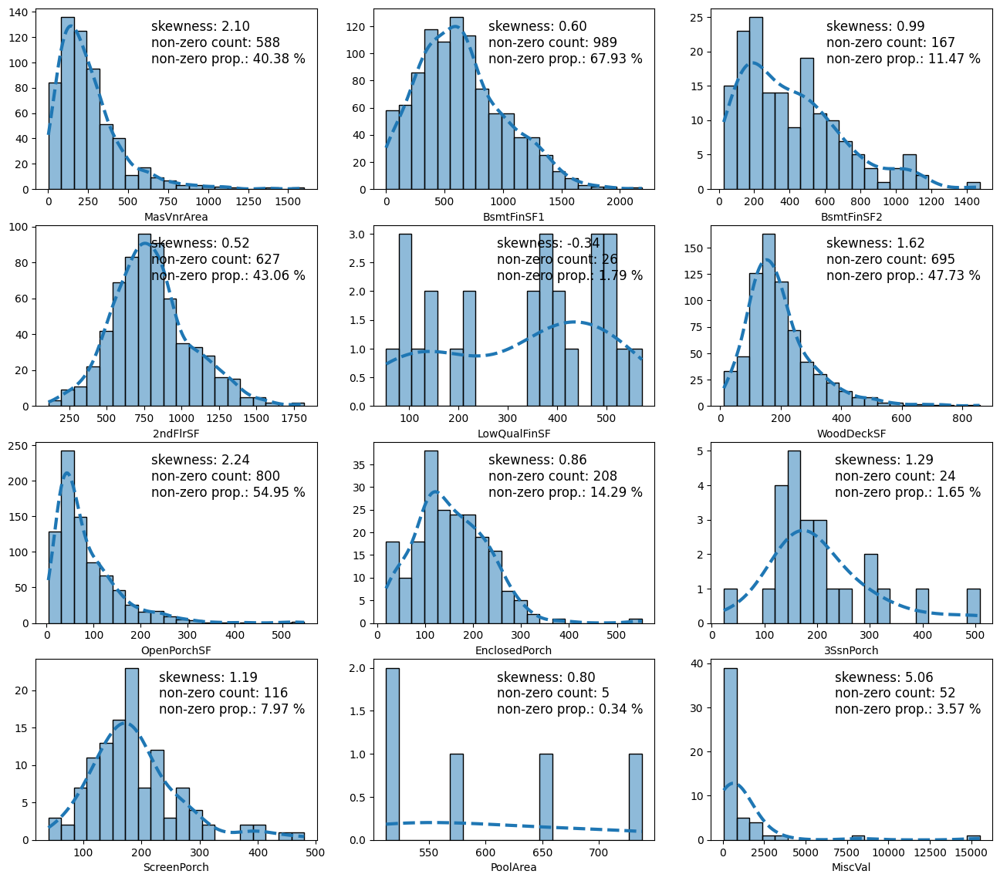

In [77]:
plot_hist_matrix(temp_df, non_zero_feat, non_zero=True)

#### observation:
- some features have high skewness for non-zero value distribution
- log1p transformation will be applied to the continuous features to help decrease skewness

*back to [3.2.3 continuous numerical features](#3.2.3)* 

<a name="3.2.3.2"></a>
#### check linear relationship of each feature vs. `log_SalePrice`
correlation coefficients for each relationship are also shown in the plots:   
**Pearson (ρ) and Spearman (r) correlation coefficients** are provided

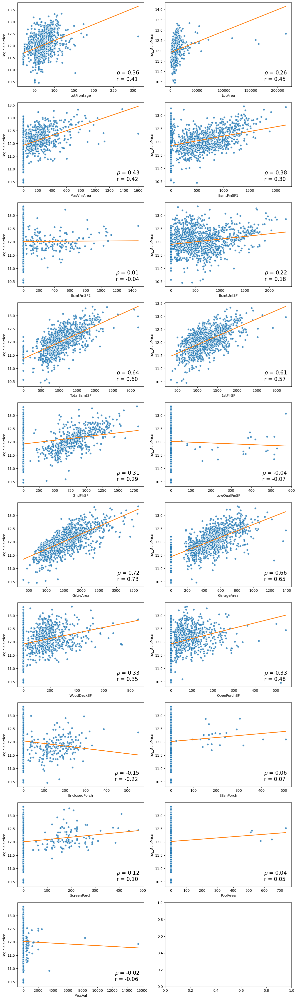

In [78]:
###### feature vs. log_SalePrice: regplot #############################
plot_feat_target(df = temp_df, feat_lst = feat_type_dict['continuous'], target_var = 'log_SalePrice', 
                 kind = 'regplot', show_corr=True)

*back to [3.2.3 continuous numerical features](#3.2.3)* 

<a name="3.2.3.3"></a>
#### compare skewness before & after log1p transformation   
**skewness calculation method:** 
- for features with zero values equal or less than 30 %, use all values to calculate skewness
- for features with zero values more than 30 %, use non-zero values to calculate skewness
- if skewness (either all-value or non-zero-value skewness) gets improved after transformation, then apply log1p transform to the feature, otherwise keep feature as the original
- use function `feat_skew_compare()`

In [79]:
###### compare skewness before & after log1p transformation #############################
###### and decide if transformation is needed for a feature #################################
skew_df = feat_skew_compare(temp_df, feat_type_dict['continuous'])
skew_df

,skew_orig,skew_log,skew_nonzero_orig,skew_nonzero_log,zero_percent,use_non_zero_skew,use_log_feat
LotFrontage,1.536818,-1.016105,1.536818,-1.016105,0.000000,0,1
LotArea,12.587561,-0.180382,12.587561,-0.180382,0.000000,0,1
MasVnrArea,2.657499,0.506128,2.101828,-0.931803,59.615385,1,1
BsmtFinSF1,0.744855,-0.616474,0.602261,-1.868209,32.074176,1,0
BsmtFinSF2,4.248587,2.518748,0.994237,-0.593767,88.530220,1,1
BsmtUnfSF,0.921759,-2.182650,0.971745,-0.751773,8.104396,0,0
TotalBsmtSF,0.486395,-5.174924,0.968119,-0.391630,2.541209,0,0
1stFlrSF,0.867081,-0.004520,0.867081,-0.004520,0.000000,0,1
2ndFlrSF,0.777866,0.295677,0.524953,-0.911354,56.936813,1,0
LowQualFinSF,8.998564,7.449565,-0.343270,-0.976811,98.214286,1,0


#### observation and summary:
- some features still have high skewness after log1p transformation
- column `use_non_zero_skew` in skew_df returned by `feat_skew_compare()` function indicates whether non-zero value skewness of the feature is used for comparison
- column `use_log_feat` in skew_df indicates whether log1p transformation will be applied to the corresponding feature


*back to [3.2.3 continuous numerical features](#3.2.3)* 

<a name="3.2.3.4"></a>
#### create log1p transformed features based on the above analysis

In [80]:
###### list of features to apply transformation / keep as original ############################
cont_feat_for_log = skew_df[skew_df['use_log_feat'] == 1].index.tolist()
cont_feat_orig = skew_df[skew_df['use_log_feat'] == 0].index.tolist()

print('\n{} continuous features for log transformation:\n\n{}'.format(len(cont_feat_for_log), cont_feat_for_log))
print('\n\n{} continuous features to keep as the original:\n\n{}'.format(len(cont_feat_orig), cont_feat_orig))


11 continuous features for log transformation:

['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF2', '1stFlrSF', 'GrLivArea', 'WoodDeckSF', 'OpenPorchSF', 'ScreenPorch', 'PoolArea', 'MiscVal']


8 continuous features to keep as the original:

['BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', '2ndFlrSF', 'LowQualFinSF', 'GarageArea', 'EnclosedPorch', '3SsnPorch']


In [81]:
###### save `cont_feat_for_log` as json file for feature engineering #########################
# with open('continuous_feat_for_log.json', 'w') as f:
#     json.dump(cont_feat_for_log, f)

In [82]:
###### apply log1p transformation to features in cont_feat_for_log ########################
log_cont_feat_lst = ['log_' + feat for feat in cont_feat_for_log]
temp_df[log_cont_feat_lst] = temp_df[cont_feat_for_log].apply(np.log1p)
temp_df[log_cont_feat_lst].shape

(1456, 11)

In [83]:
###### create final continuous feature list ########################################3
cont_feat_lst = ['log_' + feat if feat in cont_feat_for_log else feat for feat in feat_type_dict['continuous']]
# same as: cont_feat_lst = log_cont_feat_lst + cont_feat_orig

print('\nfinal continuous feature list:\n\n{}'.format(cont_feat_lst))


final continuous feature list:

['log_LotFrontage', 'log_LotArea', 'log_MasVnrArea', 'BsmtFinSF1', 'log_BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'log_1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'log_GrLivArea', 'GarageArea', 'log_WoodDeckSF', 'log_OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'log_ScreenPorch', 'log_PoolArea', 'log_MiscVal']


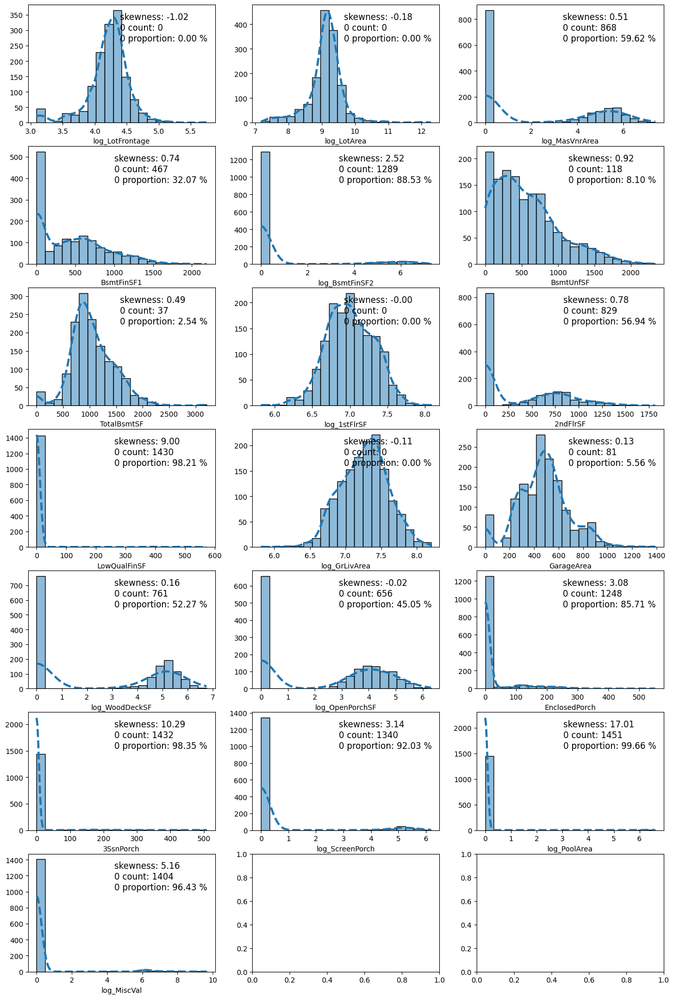

In [84]:
###### histogram matrix after transform on *selected* numerical features ##############################
plot_hist_matrix(temp_df, cont_feat_lst)

#### for some features with large proportion of zeros in `cont_feat_lst`, only plot histogram of non-zero value distributions for further check

In [85]:
large_zero_feat_lst = [feat for idx, feat in zip(skew_df['use_non_zero_skew'], cont_feat_lst) if idx == 1]
print(large_zero_feat_lst)

['log_MasVnrArea', 'BsmtFinSF1', 'log_BsmtFinSF2', '2ndFlrSF', 'LowQualFinSF', 'log_WoodDeckSF', 'log_OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'log_ScreenPorch', 'log_PoolArea', 'log_MiscVal']


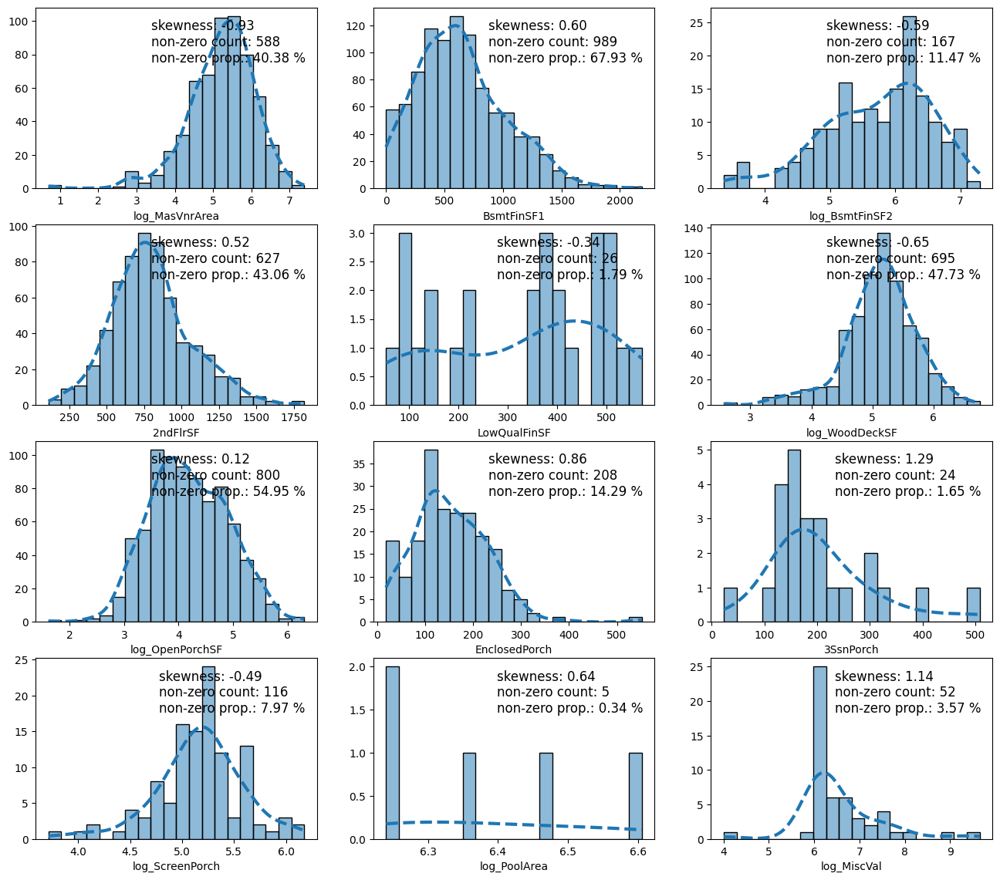

In [86]:
plot_hist_matrix(temp_df, large_zero_feat_lst, non_zero=True)

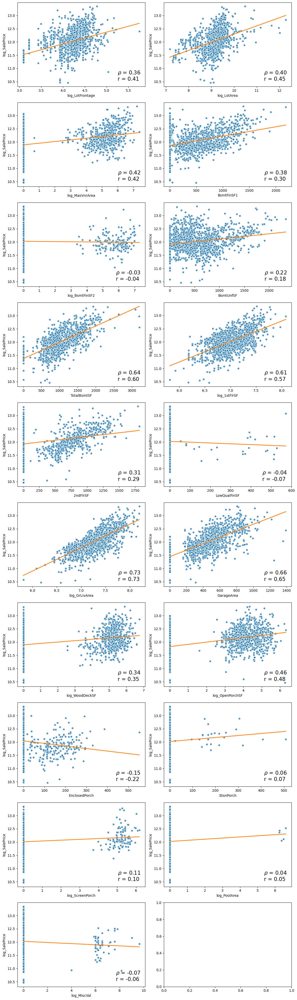

In [87]:
###### regplot after transformation on *selected* numerical features ##############################
plot_feat_target(df=temp_df, feat_lst=cont_feat_lst, target_var='log_SalePrice', 
                 kind='regplot', show_corr=True)

#### observation and summary:
- some features have low correlation coefficient with target variable `log_SalePrice`,  
  keep these features for now.
- zero-inflation problem still exists for some features:  
  for example, almost all values in feature `log_PoolArea` are 0.  


*back to [3.2.3 continuous numerical features](#3.2.3)* 

<a name="3.2.3.5"></a>
#### create categorical features from continuous features:
- for **some** features with large proportion of zeros (features in `large_zero_feat_lst`, without prefix 'log_'), create categorical features as zero/non-zero indicators (**with feature prefix 'ind_'**)
- for most features in `large_zero_feat_lst`, as well as features `TotalBsmtSF` and `GarageArea`, create categorical features to indicate if a house has a feature (**with feature prefix 'has_'**)

In [88]:
###### create new categorical features from continuous features #####################################
cont_to_cat_feat_lst = [feat.removeprefix('log_') for feat in large_zero_feat_lst] + ['TotalBsmtSF', 'GarageArea']

cont_to_cat_feat_lst_has = ['MasVnrArea', '2ndFlrSF', 'LowQualFinSF', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 
                            '3SsnPorch', 'ScreenPorch', 'PoolArea', 'TotalBsmtSF', 'GarageArea']
cat_from_cont_feat_lst_has = ['has_MasVnr', 'has_2ndFlr', 'has_LowQualFin', 'has_WoodDeck', 
                              'has_OpenPorch', 'has_EnclosedPorch', 'has_3SsnPorch', 'has_ScreenPorch', 
                              'has_Pool', 'has_Bsmt', 'has_Garage']

cont_to_cat_feat_lst_ind = [feat for feat in cont_to_cat_feat_lst if feat not in cont_to_cat_feat_lst_has]
cat_from_cont_feat_lst_ind = ['ind_' + feat for feat in cont_to_cat_feat_lst_ind]

temp_df[cat_from_cont_feat_lst_has] = temp_df[cont_to_cat_feat_lst_has].apply(lambda col: (col > 0).astype('int64'))
temp_df[cat_from_cont_feat_lst_ind] = temp_df[cont_to_cat_feat_lst_ind].apply(lambda col: (col > 0).astype('int64'))

print('\ncreate {} categorical features with prefix "_has":\n\n{}'.format(len(cont_to_cat_feat_lst_has),
                                                                          cat_from_cont_feat_lst_has))
print('\ncreate {} categorical features with prefix "_ind":\n\n{}'.format(len(cont_to_cat_feat_lst_ind), 
                                                                          cat_from_cont_feat_lst_ind))


create 11 categorical features with prefix "_has":

['has_MasVnr', 'has_2ndFlr', 'has_LowQualFin', 'has_WoodDeck', 'has_OpenPorch', 'has_EnclosedPorch', 'has_3SsnPorch', 'has_ScreenPorch', 'has_Pool', 'has_Bsmt', 'has_Garage']

create 3 categorical features with prefix "_ind":

['ind_BsmtFinSF1', 'ind_BsmtFinSF2', 'ind_MiscVal']


In [89]:
##### save `cont_to_cat_feat_lst` as json file for feature engineering #########################
# with open('continuous_to_cat_feat_lst.json', 'w') as f:
#     json.dump(cont_to_cat_feat_lst, f)

*back to [3.2.3 continuous numerical features](#3.2.3)* 

<a name="3.2.3.6"></a>
#### create new continuous features by feature interaction

In [90]:
###### create new features by feature interaction #############################
## total SF of living area: living area above ground + finished area of basement
temp_df['TotalLivArea'] = temp_df['GrLivArea'] + temp_df['BsmtFinSF1'] + temp_df['BsmtFinSF2']

## total SF of all floors: total SF of basement + 1st floor SF + 2nd floor SF
temp_df['TotalFlrSF'] = temp_df['TotalBsmtSF'] + temp_df['1stFlrSF'] + temp_df['2ndFlrSF']

## total SF of porch: OpenPorchSF + EnclosedPorch + 3SsnPorch + ScreenPorch
temp_df['TotalPorchSF'] = (temp_df['OpenPorchSF'] + temp_df['EnclosedPorch'] 
                           + temp_df['3SsnPorch'] + temp_df['ScreenPorch'])

cont_from_cont_feat_lst = ['TotalLivArea', 'TotalFlrSF', 'TotalPorchSF']

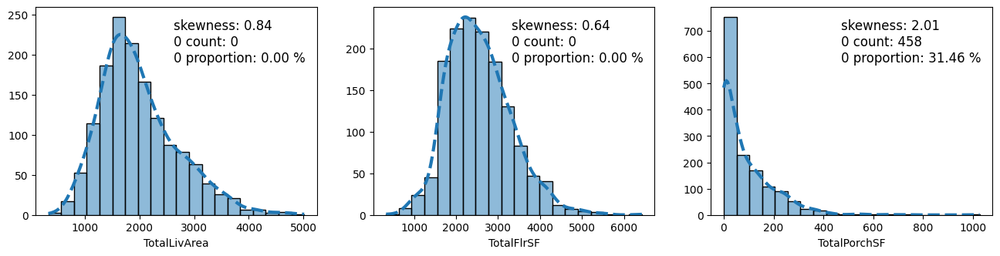

In [91]:
###### histogram matrix of new features ###############################
plot_hist_matrix(temp_df, cont_from_cont_feat_lst)

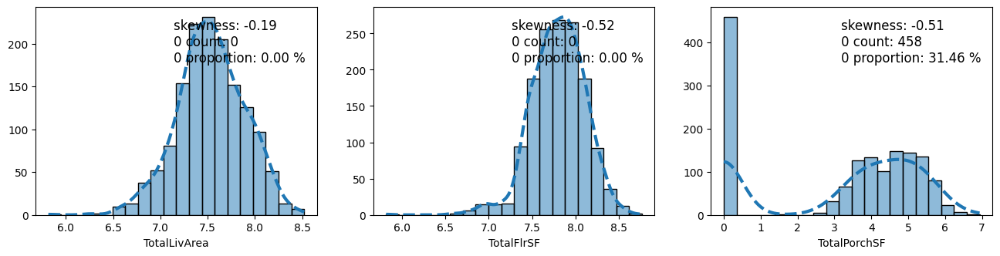

In [92]:
###### histogram matrix: log1p transformed new features ###############################
plot_hist_matrix(temp_df[cont_from_cont_feat_lst].apply(np.log1p), cont_from_cont_feat_lst)

**Since all three new features' skewness decreases after transformation, apply log transformation to the newly created continuous features.**

In [93]:
###### apply log1p transformation to new features ############################
cont_from_cont_feat_lst_log = ['log_' + feat for feat in cont_from_cont_feat_lst]
temp_df[cont_from_cont_feat_lst_log] = temp_df[cont_from_cont_feat_lst].apply(np.log1p)

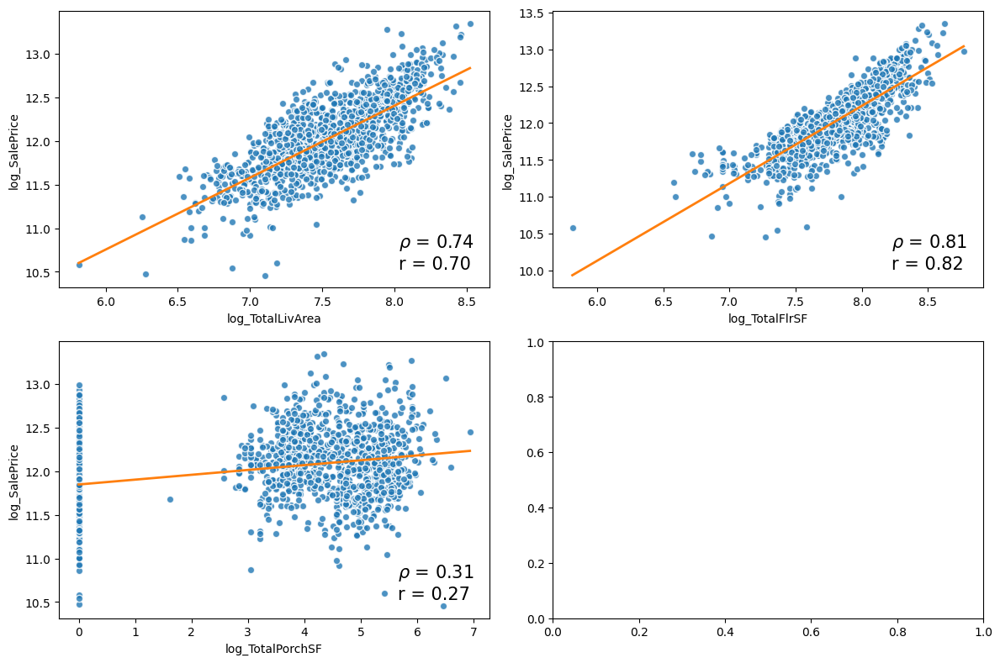

In [94]:
###### regplot of new log features vs target ###############################
plot_feat_target(df=temp_df, feat_lst=cont_from_cont_feat_lst_log, target_var='log_SalePrice', 
                 kind='regplot', show_corr=True)

*back to [3.2.3 continuous numerical features](#3.2.3)* 

### Summary of 3.2.3
#### feature analysis
- continuous features for log1p transformation: `cont_feat_for_log` (feature list)
- continuous features kept as original: `cont_feat_orig` (feature list)  
  final continous feature list (log and original mixed): `cont_feat_lst` (feature list)
- create new categorical features: `cat_from_cont_feat_lst_has` and `cat_from_cont_feat_lst_ind` (feature list)
- create new continuous features by feature interaction --> log1p transform: `cont_from_cont_feat_lst_log` (feature list)

#### feature engineering steps for continuous numerical features    
- create log1p transformed continuous features: `log_cont_feat_lst`
- create new categorical features: `cat_from_cont_feat_lst_has` and `cat_from_cont_feat_lst_ind`
- create new continuous features by feature interaction: interaction --> log1p transform: `cont_from_cont_feat_lst_log`
- drop original continous features in `cont_feat_for_log`
- MinMax Scaling


*back to [3.2 Numerical Features](#3.2)*  

*back to [3. Univariate Analysis](#3)*      
*back to [content outline](#0)*

<a name="3.3"></a>
## 3.3 Categorical Features
- [3.3.1 ordinal categorical features](#3.3.1)   
  22 ordinal features: `feat_type_dict['ordinal']`
- [3.3.2 nominal categorical features](#3.3.2)   
  23 original nominal features: `feat_type_dict['nominal']`  
  14 new nominal features created from continuous features: `cat_from_cont_feat_lst_has` and `cat_from_cont_feat_lst_ind`


**From the conclusion of 2.2.4, in all categorical features, only `MSSubClass` has less categories in train.csv than in test.csv. This cardinality problem needs to be considered.**

<a name="3.3.1"></a>
## 3.3.1 ordinal categorical features
- [create dictionary to map each ordinal feature with its *original* ordered categories](#3.3.1.0)
- [convert all ordinal features to pandas Categorical type by reordering each feature's categories](#3.3.1.1)      
  **feature `OverallQual` and `OverallCond` are already in int dtype**
- [linear/monotonic relationship of each feature vs. **log target** variable](#3.3.1.2)
- [range binning](#3.3.1.3)     
  for linear regression need, try feature range binning when monotonic relationship is not shown or not obvious between `log_SalePrice` and the feature (mentioned in dataset documentation by creator)
 

In [95]:
print('\n{} ordinal categorical features:\n\n{}'.format(len(feat_type_dict['ordinal']), feat_type_dict['ordinal']))


22 ordinal categorical features:

['LotShape', 'LandSlope', 'OverallQual', 'OverallCond', 'ExterQual', 'ExterCond', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'HeatingQC', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence']


<a name="3.3.1.0"></a>
#### create dictionary to map each ordinal feature with its *original* ordered categories    
- **feature `OverallQual` and `OverallCond` are already in int dtype**
- need to map 20 ordinal features

In [96]:
###### create dictionary to map each ordinal feature with its *original* ordered categories ########################
cat_map_dict = {'LotShape'    : ['IR3', 'IR2', 'IR1', 'Reg'], 
                'LandSlope'   : ['Gtl', 'Mod', 'Sev'], 
                'ExterQual'   : ['Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'ExterCond'   : ['Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'BsmtQual'    : ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'BsmtCond'    : ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'], 
                'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'], 
                'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'], 
                'HeatingQC'   : ['Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'Electrical'  : ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'], 
                'KitchenQual' : ['Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'Functional'  : ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'], 
                'FireplaceQu' : ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'], 
                'GarageQual'  : ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'GarageCond'  : ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                'PavedDrive'  : ['N', 'P', 'Y'], 
                'PoolQC'      : ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'], 
                'Fence'       : ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']}

<a name="3.3.1.1"></a>
#### convert 20 ordinal features to pandas Categorical type

In [97]:
###### convert 20 ordinal features to pandas Categorical type using cat_map_dict #########################
cat_to_ord_feat_lst = [feat for feat in feat_type_dict['ordinal'] if feat not in ['OverallQual', 'OverallCond']]
ord_from_cat_feat_lst = ['ord_' + feat for feat in cat_to_ord_feat_lst]

temp_df[ord_from_cat_feat_lst] = (temp_df[cat_to_ord_feat_lst]
                                  .apply(lambda col: pd.Categorical(col, categories=cat_map_dict[col.name], 
                                                                    ordered=True)))

In [98]:
###### get attributes of these ordinal features ###################
print(temp_df['ord_ExterCond'].dtype)
print(temp_df['ord_PoolQC'].cat.categories)
print(temp_df['ord_ExterCond'].cat.ordered)
# print(temp_df['ord_ExterCond'].head())

category
Index(['No Pool', 'Fa', 'TA', 'Gd', 'Ex'], dtype='object')
True


<a name="3.3.1.2"></a>
#### linear/monotonic relationship of each feature vs. **log target** variable

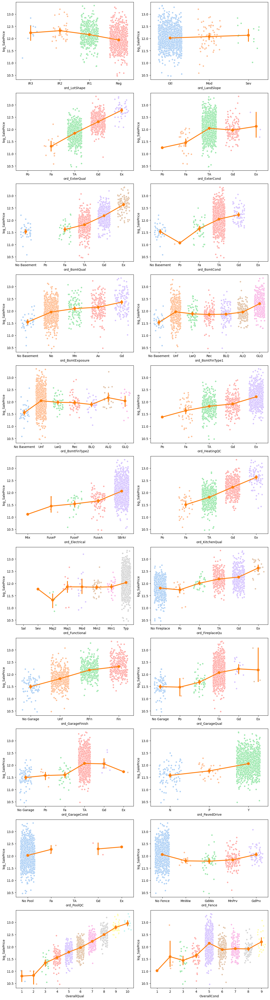

In [99]:
###### stripplot + pointplot: features vs. log_SalePrice ###########################################
plot_feat_target(df = temp_df, feat_lst = ord_from_cat_feat_lst + ['OverallQual', 'OverallCond'], 
                 target_var = 'log_SalePrice', kind = 'point_strip')

#### observation and summary:
- from the plot, it shows some features have rare categories
- some features' linear / monotonic relationship with target variable is not obvious
- **range binning for some features: merge less frequent categories to their adjacent category**


*back to [3.3.1 ordinal categorical features](#3.3.1)* 

<a name="3.3.1.3"></a>
#### range binning

In [100]:
###### range binning for some ordinal features #####################################
### create new cat_map_dict_bin
cat_map_dict_bin = {'LotShape'    : ['IR23', 'IR1', 'Reg'], # ['IR3', 'IR2', 'IR1', 'Reg']
                    'LandSlope'   : ['Gtl', 'MoSe'], # ['Gtl', 'Mod', 'Sev'] 
                    'ExterCond'   : ['PoFa', 'TA', 'GdEx'], # ['Po', 'Fa', 'TA', 'Gd', 'Ex']
                    'BsmtCond'    : ['NoPo', 'Fa', 'TA', 'Gd', 'Ex'], # ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex']
                    'HeatingQC'   : ['PoFa', 'TA', 'Gd', 'Ex'], # ['Po', 'Fa', 'TA', 'Gd', 'Ex']
                    'Electrical'  : ['MiFuPF', 'FuseA', 'SBrkr'], # ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr']
                    'Functional'  : ['SeMa12Mo', 'Min2', 'Min1', 'Typ'], # ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ']
                    'GarageQual'  : ['No Garage', 'PoFa', 'TA', 'GdEx'], # ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex']
                    'GarageCond'  : ['No Garage', 'PoFa', 'TA', 'GdEx'], # ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex']
                    'PoolQC'      : ['No Pool', 'FatoEx'], # ['No Pool', 'Fa', 'TA', 'Gd', 'Ex']
                    'Fence'       : ['No Fence', 'MnGdWo', 'MnPrv', 'GdPrv']} # ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']

**also create dictionary to map each ordinal feature with its final binned / unbinned ordered categories** 
- for ordinal encoding with `OrdinalEncoder`

In [101]:
###### final dictionary to map each ordinal feature with its binned / unbinned ordered categories ##################
cat_map_dict_full = {'LotShape'    : ['IR23', 'IR1', 'Reg'], # ['IR3', 'IR2', 'IR1', 'Reg']
                     'LandSlope'   : ['Gtl', 'MoSe'], # ['Gtl', 'Mod', 'Sev']
                     'ExterQual'   : ['Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                     'ExterCond'   : ['PoFa', 'TA', 'GdEx'], # ['Po', 'Fa', 'TA', 'Gd', 'Ex']
                     'BsmtQual'    : ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                     'BsmtCond'    : ['NoPo', 'Fa', 'TA', 'Gd', 'Ex'], # ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex']
                     'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'], 
                     'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'], 
                     'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'], 
                     'HeatingQC'   : ['PoFa', 'TA', 'Gd', 'Ex'], # ['Po', 'Fa', 'TA', 'Gd', 'Ex']
                     'Electrical'  : ['MiFuPF', 'FuseA', 'SBrkr'], # ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr']
                     'KitchenQual' : ['Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                     'Functional'  : ['SeMa12Mo', 'Min2', 'Min1', 'Typ'], # ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ']
                     'FireplaceQu' : ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'], 
                     'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'], 
                     'GarageQual'  : ['No Garage', 'PoFa', 'TA', 'GdEx'], # ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex']
                     'GarageCond'  : ['No Garage', 'PoFa', 'TA', 'GdEx'], # ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex']
                     'PavedDrive'  : ['N', 'P', 'Y'], 
                     'PoolQC'      : ['No Pool', 'FatoEx'], # ['No Pool', 'Fa', 'TA', 'Gd', 'Ex']
                     'Fence'       : ['No Fence', 'MnGdWo', 'MnPrv', 'GdPrv']} # ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']

In [102]:
###### create a list of categorical features for bin #######################
cat_for_bin_feat_lst = list(cat_map_dict_bin.keys())
bin_from_cat_feat_lst = ['bin_' + feat for feat in cat_for_bin_feat_lst]
print(cat_for_bin_feat_lst)

['LotShape', 'LandSlope', 'ExterCond', 'BsmtCond', 'HeatingQC', 'Electrical', 'Functional', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence']


#### create new features `bin_` using `.replace()` from features in the list `cat_for_bin_feat_lst`
- use category mapping dictionary `cat_map_dict_bin` for binning

In [103]:
ord_bin_dict = {'LotShape'  : {'IR3': 'IR23', 'IR2': 'IR23'},
                'LandSlope' : {'Mod': 'MoSe', 'Sev': 'MoSe'}, 
                'ExterCond' : {'Po': 'PoFa', 'Fa': 'PoFa', 'Gd': 'GdEx', 'Ex': 'GdEx'}, 
                'BsmtCond'  : {'No Basement': 'NoPo', 'Po': 'NoPo'}, 
                'HeatingQC' : {'Po': 'PoFa', 'Fa': 'PoFa'}, 
                'Electrical': {'Mix': 'MiFuPF', 'FuseP': 'MiFuPF', 'FuseF': 'MiFuPF'}, 
                'Functional': {'Sev': 'SeMa12Mo', 'Maj2': 'SeMa12Mo', 'Maj1': 'SeMa12Mo', 'Mod': 'SeMa12Mo'}, 
                'GarageQual': {'Po': 'PoFa', 'Fa': 'PoFa', 'Gd': 'GdEx', 'Ex': 'GdEx'}, 
                'GarageCond': {'Po': 'PoFa', 'Fa': 'PoFa', 'Gd': 'GdEx', 'Ex': 'GdEx'}, 
                'PoolQC'    : {'Fa': 'FatoEx', 'TA': 'FatoEx', 'Gd': 'FatoEx', 'Ex': 'FatoEx'}, 
                'Fence'     : {'MnWw': 'MnGdWo', 'GdWo': 'MnGdWo'}}

In [104]:
###### save the dictionary ################################
# with open('ord_bin_dict.json', 'w') as f:
#     json.dump(ord_bin_dict, f)

In [105]:
###### create new features 'bin_', using .replace() ######################
temp_df[bin_from_cat_feat_lst] = (temp_df[cat_for_bin_feat_lst]
                                  .replace({'LotShape': {'IR3': 'IR23', 'IR2': 'IR23'},
                                            'LandSlope': {'Mod': 'MoSe', 'Sev': 'MoSe'}, 
                                            'ExterCond': {'Po': 'PoFa', 'Fa': 'PoFa', 'Gd': 'GdEx', 'Ex': 'GdEx'}, 
                                            'BsmtCond': {'No Basement': 'NoPo', 'Po': 'NoPo'}, 
                                            'HeatingQC': {'Po': 'PoFa', 'Fa': 'PoFa'}, 
                                            'Electrical': {'Mix': 'MiFuPF', 'FuseP': 'MiFuPF', 'FuseF': 'MiFuPF'}, 
                                            'Functional': {'Sev': 'SeMa12Mo', 'Maj2': 'SeMa12Mo', 'Maj1': 'SeMa12Mo', 'Mod': 'SeMa12Mo'}, 
                                            'GarageQual': {'Po': 'PoFa', 'Fa': 'PoFa', 'Gd': 'GdEx', 'Ex': 'GdEx'}, 
                                            'GarageCond': {'Po': 'PoFa', 'Fa': 'PoFa', 'Gd': 'GdEx', 'Ex': 'GdEx'}, 
                                            'PoolQC': {'Fa': 'FatoEx', 'TA': 'FatoEx', 'Gd': 'FatoEx', 'Ex': 'FatoEx'}, 
                                            'Fence': {'MnWw': 'MnGdWo', 'GdWo': 'MnGdWo'}}))

#### create new features `bin_` for `OverallQual`, `OverallCond` using `pd.cut()`
- `OverallQual`：1,2,3 | 4 | 5 | 6 | 7 | 8 | 9,10
- `OverallCond`：1,2,3 | 4 | 5 | 6 | 7 | 8 | 9
- **range bin and ordinal encoding all at once**

In [106]:
###### create new features 'bin_' for ['OverallQual', 'OverallCond'] using .cut() ##########################
for feat in ['OverallQual', 'OverallCond']:
    bin_feat = 'bin_' + feat
    temp_df[bin_feat] = pd.cut(temp_df[feat], bins=[0, 4, 5, 6, 7, 8, 9, 15], right=False, labels=False)

#### create new features `ordbin_` by converting all the `bin_` features in `bin_from_cat_feat_lst` to ordered categorical data
- use `cat_map_dict_bin` for category mapping

In [107]:
###### create new features 'ordbin_' by converting all the `bin_` features in `bin_from_cat_feat_lst`################
ord_from_bincat_feat_lst = ['ord' + feat for feat in bin_from_cat_feat_lst]
temp_df[ord_from_bincat_feat_lst] = (temp_df[bin_from_cat_feat_lst]
                                     .apply(lambda col: pd.Categorical(col, 
                                                                       categories=cat_map_dict_bin[col.name.removeprefix('bin_')],
                                                                       ordered=True)))

#### create a list to store the ordinal features with only type conversion, no range binning

In [108]:
###### a list of ordinal features with only type conversion, no range binning ##################3
ord_nobin_from_cat_feat_lst = [feat for feat in ord_from_cat_feat_lst 
                               if feat.removeprefix('ord_') not in cat_for_bin_feat_lst]
cat_nobin_feat_lst = [feat for feat in cat_to_ord_feat_lst if feat not in cat_for_bin_feat_lst]

print('\nordinal features without range binning:\n\n{}'.format(cat_nobin_feat_lst))


ordinal features without range binning:

['ExterQual', 'BsmtQual', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'KitchenQual', 'FireplaceQu', 'GarageFinish', 'PavedDrive']


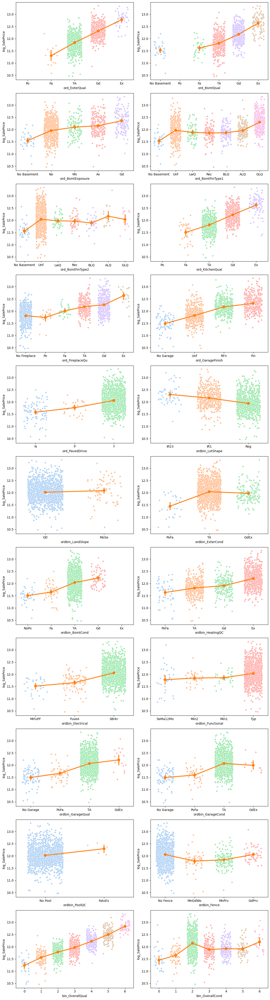

In [109]:
###### stripplot + pointplot: final ordinal (ordbin_ / ord_) features vs. log_SalePrice #######################
ord_feat_lst = ord_nobin_from_cat_feat_lst + ord_from_bincat_feat_lst + ['bin_OverallQual', 'bin_OverallCond']

plot_feat_target(df = temp_df, feat_lst = ord_feat_lst, 
                 target_var = 'log_SalePrice', kind = 'point_strip')

#### observation and summary:
- some ordinal features have obvious monotonic / linear relationship with target variable
- almost all values of feature `ordbin_PoolQC` are in the same category, little information provided, keep the feature for now


*back to [3.3.1 ordinal categorical features](#3.3.1)* 

### summary of 3.3.1
#### feature analysis
- 9 features ord_: `ord_nobin_from_cat_feat_lst` / `cat_nobin_feat_lst`: type conversion (`cat_map_dict`)
- 11 features ordbin_: `ord_from_bincat_feat_lst` / `bin_from_cat_feat_lst`/ `cat_for_bin_feat_lst`: range bin (`cat_map_dict_bin`) --> type conversion (`cat_map_dict_bin`) 
- 2 features bin_: `bin_OverallQual`, `bin_OverallCond`

#### feature engineering steps for ordinal categorical features  
- category range binning for features in `ord_from_bincat_feat_lst` / `cat_for_bin_feat_lst`
- ordinal encoding with `OrdinalEncoder`for all binned and unbinned ordinal features `cat_to_ord_feat_lst` (`cat_nobin_feat_lst` + `cat_for_bin_feat_lst`)
- `OrdinalEncoder` categoriy mapping dictionary: `cat_map_dict_full`
- 2 features `OverallQual` and `OverallCond` range bin and ordinal encoding with pd.cut() (along with discrete numerical features)
- MinMax Scaling


*back to [3.3 Categorical Features](#3.3)*  

<a name="3.3.2"></a>
## 3.3.2 nominal categorical features
- **notes:** in continuous feature analysis (3.2.3), new nominal categorical features are created (`cat_from_cont_feat_lst_has` and `cat_from_cont_feat_lst_ind`), these features are analized here together with original nominal features in the dataset
- `new_nom_feat_lst` = `cat_from_cont_feat_lst_has` + `cat_from_cont_feat_lst_ind`
- [relationship of each feature vs. **log target** variable](#3.3.2.1)
- [try binning rarely-occured categories for a feature](#3.3.2.2)
- feature `MSSubClass`
- explore creating new features


In [110]:
new_nom_feat_lst = cat_from_cont_feat_lst_has + cat_from_cont_feat_lst_ind

print('\n{} original nominal categorical features in the dataset:\n\n{}'.format(len(feat_type_dict['nominal']), 
                                                                                feat_type_dict['nominal']))
print('\n\n{} new-created nominal features based on continuous features:\n\n{}'.format(len(new_nom_feat_lst), 
                                                                                   new_nom_feat_lst))


23 original nominal categorical features in the dataset:

['MSSubClass', 'MSZoning', 'Street', 'Alley', 'LandContour', 'LotConfig', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'Foundation', 'Heating', 'CentralAir', 'GarageType', 'MiscFeature', 'SaleType', 'SaleCondition']


14 new-created nominal features based on continuous features:

['has_MasVnr', 'has_2ndFlr', 'has_LowQualFin', 'has_WoodDeck', 'has_OpenPorch', 'has_EnclosedPorch', 'has_3SsnPorch', 'has_ScreenPorch', 'has_Pool', 'has_Bsmt', 'has_Garage', 'ind_BsmtFinSF1', 'ind_BsmtFinSF2', 'ind_MiscVal']


<a name="3.3.2.1"></a>
#### relationship of each feature vs. **log target** variable

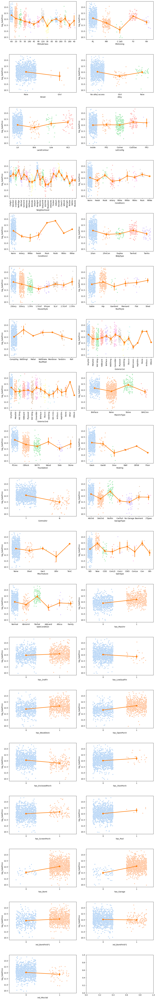

In [111]:
###### stripplot + pointplot: all nominal features vs. log_SalePrice ##########################
full_nom_feat_lst = feat_type_dict['nominal'] + new_nom_feat_lst

plot_feat_target(df = temp_df, feat_lst = full_nom_feat_lst, target_var = 'log_SalePrice', kind = 'point_strip', 
                 draw_line = True, x_rotate_feat=['Neighborhood', 'Exterior1st', 'Exterior2nd'])

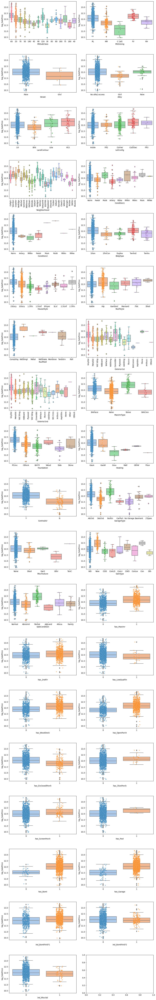

In [112]:
###### stripplot + boxplot: all nominal features vs. log_SalePrice ##########################
plot_feat_target(df = temp_df, feat_lst = full_nom_feat_lst, target_var = 'log_SalePrice', kind = 'box_strip', 
                 x_rotate_feat=['Neighborhood', 'Exterior1st', 'Exterior2nd'])

<a name="3.3.2.2"></a>
#### bin rarely-occured categories for some nominal features
- for a specific feature, rarely-occured categories are all combined into category 'other'
- **binning condition**: for a specific feature, 2 or more categories have less than 15 records
- for feature `MSSubClass`, category '150' (only in test.csv) has to be considered

In [113]:
###### create a dictionary to store categories for binning for some nominal features ##########################
### for original nominal features in the dataset
merge_cat_series = (temp_df[feat_type_dict['nominal']]
                    .apply(lambda col: (col.value_counts()[col.value_counts() < 15]).index.tolist()))

merge_cat_dict = merge_cat_series[merge_cat_series.str.len() > 1].to_dict()
merge_cat_dict['MSSubClass'] = merge_cat_dict['MSSubClass'] + ['150'] 
merge_cat_dict

{'MSSubClass': ['45', '180', '40', '150'],
 'Neighborhood': ['Veenker', 'NPkVill', 'Blueste'],
 'Condition1': ['RRAe', 'PosA', 'RRNn', 'RRNe'],
 'Condition2': ['Feedr', 'Artery', 'RRNn', 'PosA', 'PosN', 'RRAn', 'RRAe'],
 'HouseStyle': ['1.5Unf', '2.5Unf', '2.5Fin'],
 'RoofStyle': ['Flat', 'Gambrel', 'Mansard', 'Shed'],
 'RoofMatl': ['Tar&Grv', 'WdShngl', 'WdShake', 'Metal', 'Membran', 'Roll'],
 'Exterior1st': ['BrkComm', 'Stone', 'AsphShn', 'ImStucc', 'CBlock'],
 'Exterior2nd': ['ImStucc', 'Brk Cmn', 'Stone', 'AsphShn', 'Other', 'CBlock'],
 'Foundation': ['Stone', 'Wood'],
 'Heating': ['Grav', 'Wall', 'OthW', 'Floor'],
 'GarageType': ['CarPort', '2Types'],
 'MiscFeature': ['Gar2', 'Othr', 'TenC'],
 'SaleType': ['ConLD', 'ConLI', 'ConLw', 'CWD', 'Oth', 'Con'],
 'SaleCondition': ['Alloca', 'AdjLand']}

In [114]:
##### save `merge_cat_dict` as json file for feature engineering #########################
# with open('merge_cat_dict.json', 'w') as f:
#     json.dump(merge_cat_dict, f)

In [115]:
###### category binning for some nominal features #########################################
### use merge_cat_dict
nom_for_bin_feat_lst = list(merge_cat_dict.keys())
bin_from_nom_feat_lst = ['bin_' + feat for feat in nom_for_bin_feat_lst]

temp_df[bin_from_nom_feat_lst] = (temp_df[nom_for_bin_feat_lst]
                                  .apply(lambda col: np.where(col.isin(merge_cat_dict[col.name]), 'other', col)))

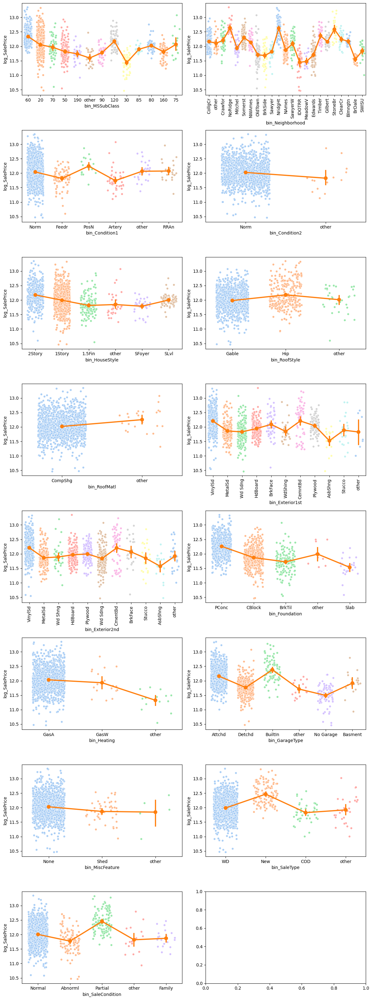

In [116]:
###### stripplot + pointplot: binned nominal features vs. log_SalePrice ##########################
plot_feat_target(df = temp_df, feat_lst = bin_from_nom_feat_lst, target_var = 'log_SalePrice', kind = 'point_strip', 
                 draw_line = True, x_rotate_feat=['bin_Neighborhood', 'bin_Exterior1st', 'bin_Exterior2nd'])

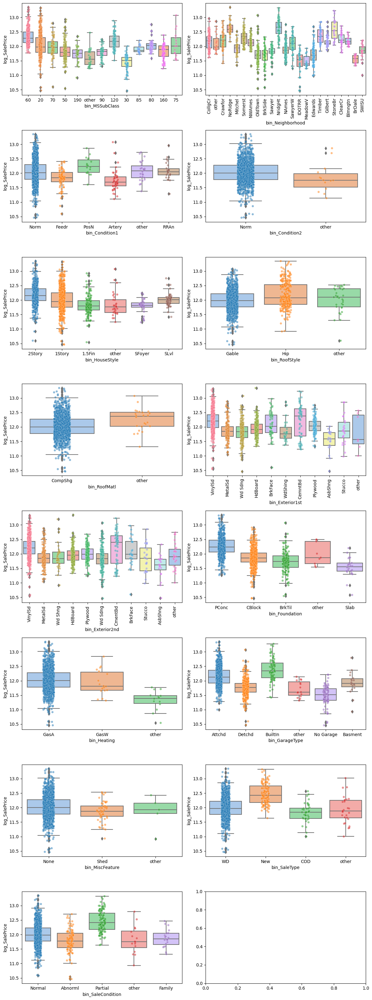

In [117]:
###### stripplot + boxplot: binned nominal features vs. log_SalePrice ##########################
plot_feat_target(df = temp_df, feat_lst = bin_from_nom_feat_lst, target_var = 'log_SalePrice', kind = 'box_strip', 
                 x_rotate_feat=['bin_Neighborhood', 'bin_Exterior1st', 'bin_Exterior2nd'])

In [118]:
###### a list of nominal features to keep as original #############################
nom_feat_orig = [feat for feat in full_nom_feat_lst if feat not in nom_for_bin_feat_lst]

###### final nominal feature list
nom_feat_lst = ['bin_' + feat if feat in nom_for_bin_feat_lst else feat for feat in full_nom_feat_lst]

### summary of 3.3.2
#### feature analysis
- list of new-created nominal features based on continuous features: `new_nom_feat_lst`
- list of all nominal features (original + new_created): `full_nom_feat_lst`
- create a dictionary to store categories for binning for some nominal features: `merge_cat_dict`
- a list of nominal features for binning: `nom_for_bin_feat_lst` / `bin_from_nom_feat_lst`
- category bin for some features: for a feature, combine 2 or more categories with each less than 15 records and set to 'other': use `merge_cat_dict`
- a list of nominal features to keep as original: `nom_feat_orig`
- final nominal feature list (original & 'bin_' mixed): `nom_feat_lst`

#### feature engineering steps for nominal categorical features  
- category binning for features in `nom_for_bin_feat_lst` / `bin_from_nom_feat_lst`
- onehot encoding for all binned and unbinned nominal features: `nom_feat_lst`/ `full_nom_feat_lst`


*back to [3.3 Categorical Features](#3.3)*  

*back to [3. Univariate Analysis](#3)*      
*back to [content outline](#0)*

<a name="4"></a>
## EDA Part 1 summary

**Since some original features are removed and some new features are created, an updated feature type dictionary is created to store all features.**
- this dictionary is used in upcomming EDA Part 2 phase
- all features in the dictionary are preprocessed (except for onehot encoding and ordinal features' encoding) and stored in `temp_df`
- in feature engineering phase, no need to convert data type of ordinal categorical features: bin --> ordinal encoding

In [119]:
###### update dictionary for feature type segmentation in temp_df ####################################
### all features in the dictionary are preprocessed (except for onehot encoding and ordinal encoding)
feat_type_dict_update = {'nominal': nom_feat_lst, 
                         'ordinal': ord_from_bincat_feat_lst + ord_nobin_from_cat_feat_lst + ['bin_OverallQual', 'bin_OverallCond'], 
                         'discrete': bin_discrete_feat_lst_new + ['bin_TotalBath'], 
                                      # bin & ordinal encoded (original + 1 new), drop `MoSold`
                         'year': new_year_feat_lst, # new-created , imputation for 'GarageAge'
                         'continuous': cont_feat_lst + cont_from_cont_feat_lst_log}

In [120]:
###### 2nd version of feat_type_dict_update #####################################################
### remove prefix, only keep prefix if a feature starts with 'has_' or 'ind_'
feat_type_dict_update_v2 = dict()
for key, lst in feat_type_dict_update.items():
    feat_type_dict_update_v2[key] = [re.sub(r'^[^hi].+_', '', feat) for feat in feat_type_dict_update[key]]

In [121]:
###### print feat_type_dict_update: import json ##############################################
print (json.dumps(feat_type_dict_update, indent=2, default=str))

{
  "nominal": [
    "bin_MSSubClass",
    "MSZoning",
    "Street",
    "Alley",
    "LandContour",
    "LotConfig",
    "bin_Neighborhood",
    "bin_Condition1",
    "bin_Condition2",
    "BldgType",
    "bin_HouseStyle",
    "bin_RoofStyle",
    "bin_RoofMatl",
    "bin_Exterior1st",
    "bin_Exterior2nd",
    "MasVnrType",
    "bin_Foundation",
    "bin_Heating",
    "CentralAir",
    "bin_GarageType",
    "bin_MiscFeature",
    "bin_SaleType",
    "bin_SaleCondition",
    "has_MasVnr",
    "has_2ndFlr",
    "has_LowQualFin",
    "has_WoodDeck",
    "has_OpenPorch",
    "has_EnclosedPorch",
    "has_3SsnPorch",
    "has_ScreenPorch",
    "has_Pool",
    "has_Bsmt",
    "has_Garage",
    "ind_BsmtFinSF1",
    "ind_BsmtFinSF2",
    "ind_MiscVal"
  ],
  "ordinal": [
    "ordbin_LotShape",
    "ordbin_LandSlope",
    "ordbin_ExterCond",
    "ordbin_BsmtCond",
    "ordbin_HeatingQC",
    "ordbin_Electrical",
    "ordbin_Functional",
    "ordbin_GarageQual",
    "ordbin_GarageCond",
    

In [122]:
###### print feat_type_dict_update_v2 ##################################################
print (json.dumps(feat_type_dict_update_v2, indent=2, default=str))

{
  "nominal": [
    "MSSubClass",
    "MSZoning",
    "Street",
    "Alley",
    "LandContour",
    "LotConfig",
    "Neighborhood",
    "Condition1",
    "Condition2",
    "BldgType",
    "HouseStyle",
    "RoofStyle",
    "RoofMatl",
    "Exterior1st",
    "Exterior2nd",
    "MasVnrType",
    "Foundation",
    "Heating",
    "CentralAir",
    "GarageType",
    "MiscFeature",
    "SaleType",
    "SaleCondition",
    "has_MasVnr",
    "has_2ndFlr",
    "has_LowQualFin",
    "has_WoodDeck",
    "has_OpenPorch",
    "has_EnclosedPorch",
    "has_3SsnPorch",
    "has_ScreenPorch",
    "has_Pool",
    "has_Bsmt",
    "has_Garage",
    "ind_BsmtFinSF1",
    "ind_BsmtFinSF2",
    "ind_MiscVal"
  ],
  "ordinal": [
    "LotShape",
    "LandSlope",
    "ExterCond",
    "BsmtCond",
    "HeatingQC",
    "Electrical",
    "Functional",
    "GarageQual",
    "GarageCond",
    "PoolQC",
    "Fence",
    "ExterQual",
    "BsmtQual",
    "BsmtExposure",
    "BsmtFinType1",
    "BsmtFinType2",
    "Ki

#### create `EDA_df`, a subset of `temp_df`, to only store features in `feat_type_dict_update`

In [123]:
EDA_feat_lst = [feat for lst in feat_type_dict_update.values() for feat in lst]
EDA_df = temp_df[EDA_feat_lst + ['SalePrice', 'log_SalePrice']]
EDA_df.shape

(1456, 96)

In [124]:
dataset_summarize(EDA_df, include_cat=True)

number of variables in dtype 'category': 20 

number of variables in dtype 'object': 23 

number of variables in dtype 'int' or 'float': 53 

data frame shape: (1456, 96) 

missing value percentage:  0.00 %


#### save some data frames and dictionary to files
- **save `EDA_df` as a .csv file 'EDA_essential.csv' to store all the processed features needed for further EDA**
- **save `temp_df` as a .csv file 'EDA_redundant.csv' to store the original and processed features in EDA, all features in 'train.csv' are included (only feature `GarageYrBlt` has missing data)**
- **save dictionary `feat_type_dict` as a .json file 'feat_type_dict.json'**
- **save dictionary `feat_type_dict_update`, `feat_type_dict_update_v2` as .json files:
  'feat_type_dict_update.json', 'feat_type_dict_update_v2.json'**
- **save dictionary `cat_map_dict`, `cat_map_dict_bin`, `cat_map_dict_full` as .json files:  
   'cat_map_dict.json', 'cat_map_dict_bin.json', 'cat_map_dict_full.json'**


In [125]:
###### save EDA_df as a .csv file #############################################
# EDA_df.to_csv('EDA_essential.csv',index=False) # only include processed features needed for further EDA

In [126]:
###### save temp_df as a .csv file #############################################
# temp_df.to_csv('EDA_redundant.csv',index=False)
## include all original and processed features in EDA, all features in 'train.csv' are included
## only feature `GarageYrBlt` has missing data

In [127]:
###### save some dictionaries as json files ##########################################
dict_lst = [feat_type_dict, feat_type_dict_update, feat_type_dict_update_v2, 
            cat_map_dict, cat_map_dict_bin, cat_map_dict_full]
dict_to_file_names = ['feat_type_dict.json', 'feat_type_dict_update.json', 'feat_type_dict_update_v2.json',
                      'cat_map_dict.json', 'cat_map_dict_bin.json', 'cat_map_dict_full.json']

# for i in range(len(dict_lst)):
#     with open(dict_to_file_names[i], 'w') as f:
#         json.dump(dict_lst[i], f)

*back to [content outline](#0)*